In [1]:
import os
import math
from collections import Counter
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import plotly.graph_objects as go

from sklearn.svm import SVC
from sklearn.model_selection import train_test_split, GridSearchCV, RandomizedSearchCV
from sklearn.metrics import classification_report, roc_auc_score, confusion_matrix, roc_curve, auc
from sklearn.preprocessing import OneHotEncoder, Normalizer, StandardScaler
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.linear_model import Lasso, SGDClassifier, LogisticRegression
from sklearn.calibration import CalibratedClassifierCV
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.model_selection import StratifiedShuffleSplit
from sklearn.model_selection._search import ParameterGrid

from xgboost import XGBClassifier
from scipy.sparse import hstack

from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from imblearn.pipeline import Pipeline

from prettytable import PrettyTable
summary = PrettyTable()
summary.field_names = ['Task','Encoding','Upsampling','Classifier','+ve class Prec/Rec','Auc ROC']

!pip install category_encoders


In [2]:
df = pd.read_table('orange_small_train.data')
print(df.shape)
df.head()

(50000, 230)


,Var1,Var2,Var3,Var4,Var5,Var6,Var7,Var8,Var9,Var10,...,Var221,Var222,Var223,Var224,Var225,Var226,Var227,Var228,Var229,Var230
0,NaN,NaN,NaN,NaN,NaN,1526.0,7.0,NaN,NaN,NaN,...,oslk,fXVEsaq,jySVZNlOJy,NaN,NaN,xb3V,RAYp,F2FyR07IdsN7I,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,525.0,0.0,NaN,NaN,NaN,...,oslk,2Kb5FSF,LM8l689qOp,NaN,NaN,fKCe,RAYp,F2FyR07IdsN7I,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,5236.0,7.0,NaN,NaN,NaN,...,Al6ZaUT,NKv4yOc,jySVZNlOJy,NaN,kG3k,Qu4f,02N6s8f,ib5G6X1eUxUn6,am7c,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,...,oslk,CE7uk3u,LM8l689qOp,NaN,NaN,FSa2,RAYp,F2FyR07IdsN7I,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,1029.0,7.0,NaN,NaN,NaN,...,oslk,1J2cvxe,LM8l689qOp,NaN,kG3k,FSa2,RAYp,F2FyR07IdsN7I,mj86,NaN


In [3]:
df.describe(include='all')

,Var1,Var2,Var3,Var4,Var5,Var6,Var7,Var8,Var9,Var10,...,Var221,Var222,Var223,Var224,Var225,Var226,Var227,Var228,Var229,Var230
count,702.000000,1241.000000,1240.000000,1579.000000,1.487000e+03,44471.000000,44461.000000,0.0,702.000000,1.487000e+03,...,50000,50000,44789,820,23856,50000,50000,50000,21568,0.0
unique,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,7,4291,4,1,3,23,7,30,4,NaN
top,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,oslk,catzS2D,LM8l689qOp,4n2X,ELof,FSa2,RAYp,F2FyR07IdsN7I,am7c,NaN
freq,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,37009,4441,36608,820,11072,8031,35156,32703,11689,NaN
mean,11.487179,0.004029,425.298387,0.125396,2.387933e+05,1326.437116,6.809496,NaN,48.145299,3.926057e+05,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,40.709951,0.141933,4270.193518,1.275481,6.441259e+05,2685.693668,6.326053,NaN,154.777855,9.280896e+05,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,NaN,0.000000,0.000000e+00,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,0.000000,0.000000,0.000000,0.000000,0.000000e+00,518.000000,0.000000,NaN,4.000000,0.000000e+00,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,0.000000,0.000000,0.000000,0.000000,0.000000e+00,861.000000,7.000000,NaN,20.000000,0.000000e+00,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,16.000000,0.000000,0.000000,0.000000,1.187425e+05,1428.000000,7.000000,NaN,46.000000,2.628630e+05,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [4]:
df.dtypes.unique()

array([dtype('float64'), dtype('int64'), dtype('O')], dtype=object)

### Investigation of Missing Values

In [6]:
df.isnull().sum()

Var1      49298
Var2      48759
Var3      48760
Var4      48421
Var5      48513
          ...  
Var226        0
Var227        0
Var228        0
Var229    28432
Var230    50000
Length: 230, dtype: int64

Minimum missing values : 0
Maximum missing values : 50000


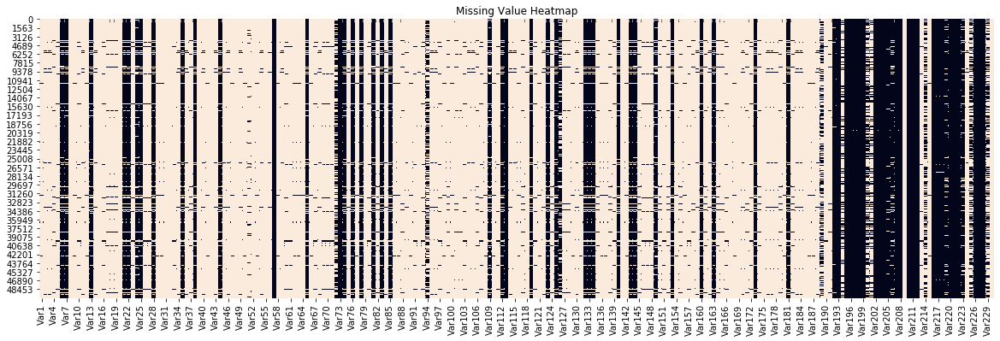

In [8]:
missing_vals = [i for i in df.isna().sum()]
print('Minimum missing values :', min(missing_vals))
print('Maximum missing values :', max(missing_vals))


plt.figure(figsize=(20,6))
plt.title('Missing Value Heatmap')
plt.xlabel('Features')
plt.ylabel('Indices of Dataframe')
sns.heatmap(df.isnull(), cbar=False)
plt.show()

<p><center>(In the above heatmap, darker shade means no missing value.)</center></p>
<br>
<p>This implies that we have lot of features with missing values, and few features with no or minimal missing values.</p>

<p>We must do quantative analysis and try to calculate following for each feature:</p>

* Number of missing values
* Percentage of missing values

In [3]:
missing_vals_per = [df[i].isna().sum()*100/len(df[i]) for i in df]

In [82]:
go.Figure(go.Scatter(
    x = np.array(range(230)),
    y = missing_vals_per
))

fig.update_layout(title='Feature wise Missing Values Plot',
                  xaxis_title="Features",
                  yaxis_title="Percentage of missing values",
                  xaxis = dict(
                    tickmode = 'array',
                    tickvals = np.array(range(230)),
                    ticktext = df.columns.values
                    )
                 )
fig.show()

Number of features with less than 30 percent missing values (red line) =  67
Number of features with > 30 and < 90 percent missing values =  9
Number of features with more more than 90 percent missing values =  136
Number of features with 100 percent missing values =  18
----------------------------------------


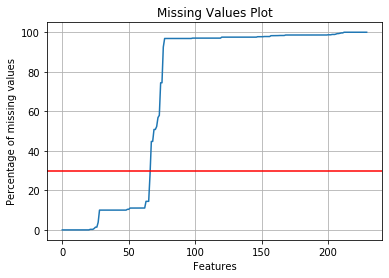

In [5]:
print('Number of features with less than 30 percent missing values (red line) = ', len([i for i in missing_vals_per if i < 30]))
print('Number of features with > 30 and < 90 percent missing values = ', len([i for i in missing_vals_per if i > 30 and i < 90]))
print('Number of features with more more than 90 percent missing values = ', len([i for i in missing_vals_per if i > 90 and i != 100]))
print('Number of features with 100 percent missing values = ', len([i for i in missing_vals_per if i == 100]))
print('-'*40)

plt.plot(sorted(missing_vals_per))
plt.axhline(y=30, color='r', linestyle='-')
plt.xlabel('Features')
plt.ylabel('Percentage of missing values')
plt.title('Missing Values Plot')
plt.grid()
plt.show()

#### Adding Missing Indicator Features for all variables

In [4]:
# Code reference : https://stackoverflow.com/a/45121967

df_missing_indicator = df.isna().astype(int).add_suffix('_indicator')

print(df_missing_indicator.shape)
df_missing_indicator.head()

(50000, 230)


,Var1_indicator,Var2_indicator,Var3_indicator,Var4_indicator,Var5_indicator,Var6_indicator,Var7_indicator,Var8_indicator,Var9_indicator,Var10_indicator,...,Var221_indicator,Var222_indicator,Var223_indicator,Var224_indicator,Var225_indicator,Var226_indicator,Var227_indicator,Var228_indicator,Var229_indicator,Var230_indicator
0,1,1,1,1,1,0,0,1,1,1,...,0,0,0,1,1,0,0,0,1,1
1,1,1,1,1,1,0,0,1,1,1,...,0,0,0,1,1,0,0,0,1,1
2,1,1,1,1,1,0,0,1,1,1,...,0,0,0,1,0,0,0,0,0,1
3,1,1,1,1,1,1,0,1,1,1,...,0,0,0,1,1,0,0,0,1,1
4,1,1,1,1,1,0,0,1,1,1,...,0,0,0,1,0,0,0,0,0,1


<p>For now, we will remove all the features with more than 30% missing values and do imputation on remaining features.</p>

In [5]:
threshold = 30
df_short = df.drop([i for i,j in dict(zip(df.columns.values, missing_vals_per)).items() if j > threshold], axis=1)

del df

print(df_short.shape)
df_short.head()

(50000, 67)


,Var6,Var7,Var13,Var21,Var22,Var24,Var25,Var28,Var35,Var38,...,Var217,Var218,Var219,Var220,Var221,Var222,Var223,Var226,Var227,Var228
0,1526.0,7.0,184.0,464.0,580.0,14.0,128.0,166.56,0.0,3570.0,...,sH5Z,cJvF,FzaX,1YVfGrO,oslk,fXVEsaq,jySVZNlOJy,xb3V,RAYp,F2FyR07IdsN7I
1,525.0,0.0,0.0,168.0,210.0,2.0,24.0,353.52,0.0,4764966.0,...,NaN,NaN,FzaX,0AJo2f2,oslk,2Kb5FSF,LM8l689qOp,fKCe,RAYp,F2FyR07IdsN7I
2,5236.0,7.0,904.0,1212.0,1515.0,26.0,816.0,220.08,0.0,5883894.0,...,bHR7,UYBR,FzaX,JFM1BiF,Al6ZaUT,NKv4yOc,jySVZNlOJy,Qu4f,02N6s8f,ib5G6X1eUxUn6
3,NaN,0.0,0.0,NaN,0.0,NaN,0.0,22.08,0.0,0.0,...,eKej,UYBR,FzaX,L91KIiz,oslk,CE7uk3u,LM8l689qOp,FSa2,RAYp,F2FyR07IdsN7I
4,1029.0,7.0,3216.0,64.0,80.0,4.0,64.0,200.00,0.0,0.0,...,H3p7,UYBR,FzaX,OrnLfvc,oslk,1J2cvxe,LM8l689qOp,FSa2,RAYp,F2FyR07IdsN7I


#### Checking for entire rows that have missing values

In [15]:
df_short.isna().all(axis=1).sum()

0

### Merging Target Variables to check class imbalance

In [6]:
appetency = pd.read_table('orange_small_train_appetency.labels', header=None)
appetency.columns = ['appetency']

churn     = pd.read_table('orange_small_train_churn.labels', header=None)
churn.columns = ['churn']

upselling = pd.read_table('orange_small_train_upselling.labels', header=None)
upselling.columns = ['upselling']

df_new = pd.concat([df_short,appetency,churn,upselling,df_missing_indicator],axis=1)

print(df_new.shape)
df_new.head()

(50000, 300)


,Var6,Var7,Var13,Var21,Var22,Var24,Var25,Var28,Var35,Var38,...,Var221_indicator,Var222_indicator,Var223_indicator,Var224_indicator,Var225_indicator,Var226_indicator,Var227_indicator,Var228_indicator,Var229_indicator,Var230_indicator
0,1526.0,7.0,184.0,464.0,580.0,14.0,128.0,166.56,0.0,3570.0,...,0,0,0,1,1,0,0,0,1,1
1,525.0,0.0,0.0,168.0,210.0,2.0,24.0,353.52,0.0,4764966.0,...,0,0,0,1,1,0,0,0,1,1
2,5236.0,7.0,904.0,1212.0,1515.0,26.0,816.0,220.08,0.0,5883894.0,...,0,0,0,1,0,0,0,0,0,1
3,NaN,0.0,0.0,NaN,0.0,NaN,0.0,22.08,0.0,0.0,...,0,0,0,1,1,0,0,0,1,1
4,1029.0,7.0,3216.0,64.0,80.0,4.0,64.0,200.00,0.0,0.0,...,0,0,0,1,0,0,0,0,0,1


Text(0.5, 1.0, 'upselling distribution')

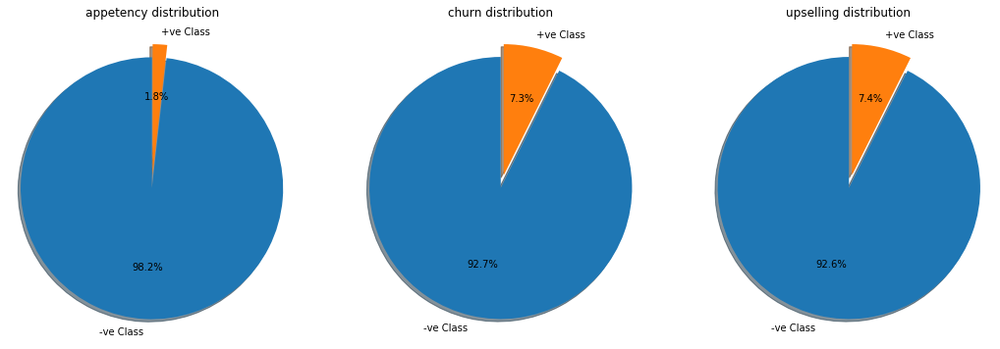

In [7]:
labels = '-ve Class', '+ve Class'
appetency_sizes = list(df_new.appetency.value_counts())
churn_sizes = list(df_new.churn.value_counts())
upselling_sizes = list(df_new.upselling.value_counts())
explode = (0.1, 0)  # only "explode" 1 slice

fig, (ax1,ax2,ax3) = plt.subplots(1,3, figsize=(18,6))
ax1.pie(appetency_sizes, explode=explode, labels=labels, autopct='%1.1f%%',
        shadow=True, startangle=90)
ax1.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
ax1.set_title('appetency distribution')

ax2.pie(churn_sizes, explode=explode, labels=labels, autopct='%1.1f%%',
        shadow=True, startangle=90)
ax2.axis('equal')
ax2.set_title('churn distribution')

ax3.pie(upselling_sizes, explode=explode, labels=labels, autopct='%1.1f%%',
        shadow=True, startangle=90)
ax3.axis('equal')
ax3.set_title('upselling distribution')


In [13]:
sns.pairplot(df_new.drop('appetency',axis=1), height=4)
plt.show()

### Storing Numerical and Categorical columns names seperately

In [7]:
print('Types of columns :', df_short.dtypes.unique())

num_columns = df_short.select_dtypes(exclude=['O']).columns.values
object_columns = [i for i in df_short.columns.values if i not in num_columns]

print('Numerical features :', len(num_columns) - 3) # Sutracting 3 target features
print('Object features :', len(object_columns))

Types of columns : [dtype('float64') dtype('int64') dtype('O')]
Numerical features : 36
Object features : 28


#### Checking for columns with standard deviation of zero

In [19]:
remove = []
for col in num_columns:
    if df_short[col].std() == 0:
        remove.append(col)
    
remove

[]

#### Checking for duplicate columns

In [8]:
df_short.T.drop_duplicates().T.columns.values

array(['Var6', 'Var7', 'Var13', 'Var21', 'Var22', 'Var24', 'Var25',
       'Var28', 'Var35', 'Var38', 'Var44', 'Var57', 'Var65', 'Var73',
       'Var74', 'Var76', 'Var78', 'Var81', 'Var83', 'Var85', 'Var109',
       'Var112', 'Var113', 'Var119', 'Var123', 'Var125', 'Var126',
       'Var132', 'Var133', 'Var134', 'Var140', 'Var143', 'Var144',
       'Var149', 'Var153', 'Var160', 'Var163', 'Var173', 'Var181',
       'Var192', 'Var193', 'Var195', 'Var196', 'Var197', 'Var198',
       'Var199', 'Var202', 'Var203', 'Var204', 'Var205', 'Var206',
       'Var207', 'Var208', 'Var210', 'Var211', 'Var212', 'Var216',
       'Var217', 'Var218', 'Var219', 'Var220', 'Var221', 'Var222',
       'Var223', 'Var226', 'Var227', 'Var228'], dtype=object)

## Churn

#### Splitting Data

In [90]:
X_train, X_test, y_train, y_test = train_test_split(df_new.drop(['churn','appetency','upselling'],axis=1), df_new['upselling'], stratify=df_new['upselling'], test_size=0.2, random_state=42)

# y_train = y_train.replace(-1,0).values
# y_test = y_test.replace(-1,0).values

print(X_train.shape, y_train.shape)
print(X_test.shape, y_test.shape)

(40000, 297) (40000,)
(10000, 297) (10000,)


Adding number of null items in row count as new feature

In [91]:
X_train = X_train.assign(num_na_count=X_train.isna().sum(axis=1).values)
X_train = X_train.assign(num_zero_count=(X_train == 0).sum(axis=1).values)
X_test = X_test.assign(num_na_count=X_test.isna().sum(axis=1).values)
X_test = X_test.assign(num_zero_count=(X_test == 0).sum(axis=1).values)

print(X_train.shape)
print(X_test.shape)

(40000, 299)
(10000, 299)


#### Checking for correlation

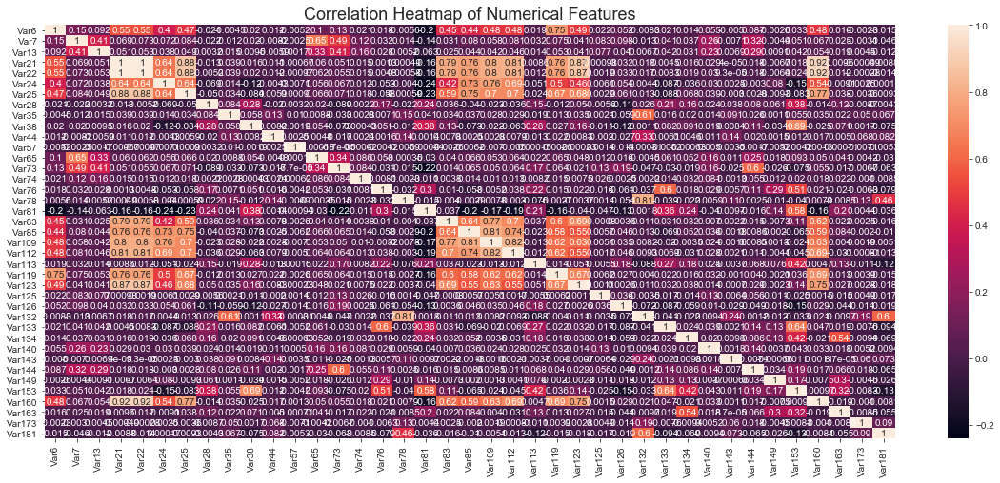

In [25]:
correlation = X_train[num_columns].corr()

sns.set_style('ticks')
fig, ax = plt.subplots()
fig.set_size_inches(20, 8)
sns.heatmap(correlation,
    xticklabels=correlation.columns,
    yticklabels=correlation.columns,
    ax=ax,annot=True)
plt.title('Correlation Heatmap of Numerical Features', fontsize = 18)
plt.show()

We see Var21 is perfectly correlated with Var22.

### Numerical Value Imputation

Mean replacement of missing values in train and test

In [92]:
X_train = X_train.fillna(X_train.mean())
X_test = X_test.fillna(X_train.mean())

Checking if we missed some numerical missing values

In [27]:
X_train[num_columns].isna().sum().unique()

array([0], dtype=int64)

### Categorical Values Imputation

In [47]:
unique_values = dict(zip(object_columns, [len(X_train[i].unique()) for i in object_columns]))
unique_values = {k: v for k, v in sorted(unique_values.items(), key=lambda item: item[1])}
object_columns = list(unique_values.keys())

Number of features with less than 500 unique values =  21
Number of features with > 500 and < 6000 unique values =  6
Number of features with more more than 6000 unique values =  1
----------------------------------------


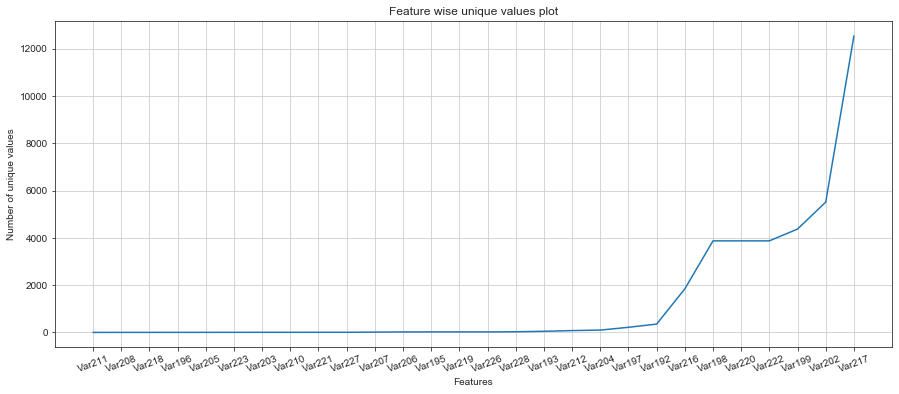

In [41]:
values_count = list(unique_values.values())

print('Number of features with less than 500 unique values = ', len([i for i in values_count if i < 500]))
print('Number of features with > 500 and < 6000 unique values = ', len([i for i in values_count if i > 500 and i < 6000]))
print('Number of features with more more than 6000 unique values = ', len([i for i in values_count if i > 6000]))
print('-'*40)

plt.figure(figsize=(15,6))
plt.plot(sorted(values_count))
plt.xlabel('Features')
plt.xticks(np.arange(28),object_columns,rotation=20)
plt.ylabel('Number of unique values')
plt.title('Feature wise unique values plot')
plt.grid()
plt.show()

One feature Var217 has more than 12000 unique values, and around 6 features have unique values between 500 and 6000.

This shows we have high cardinality in some of the categorical features.

For now, we will build some classifiers with different encoding methods and check the performance.

Treating missing values as 'unknown' category

In [93]:
X_train = X_train.fillna('Unknown')
X_test = X_test.fillna('Unknown')

Checking if any we missed any missing cells

In [43]:
X_train.isna().sum().unique()

array([0], dtype=int64)

### Encoding Categorical Variables

#### One Hot Encoding

In [45]:
ohe = OneHotEncoder(handle_unknown='ignore')
ohe.fit(X_train[object_columns].iloc[:,:-1]) # Omitting top feaure with maximum unique values

cate_train_encoded = ohe.transform(X_train[object_columns].iloc[:,:-1])
cate_test_encoded = ohe.transform(X_test[object_columns].iloc[:,:-1])

cate_features = ohe.get_feature_names()

print(cate_train_encoded.shape)
print(cate_test_encoded.shape)

(40000, 24331)
(10000, 24331)


#### Leave One Out Encoding

http://contrib.scikit-learn.org/category_encoders/leaveoneout.html

In [97]:
from category_encoders.leave_one_out import LeaveOneOutEncoder

In [105]:
encoder = LeaveOneOutEncoder(sigma=0.05).fit(X_train[object_columns],y_train)

loue_train_df = encoder.transform(X_train[object_columns],y_train)
loue_test_df = encoder.transform(X_test[object_columns],y_test)

loue_features = encoder.get_feature_names()

print(loue_train_df.shape)
print(loue_test_df.shape)

(40000, 28)
(10000, 28)


#### Binary Encoding

In [129]:
from category_encoders.binary import BinaryEncoder

In [132]:
binary_enco = BinaryEncoder().fit(X_train[object_columns],y_train)

binary_train_df = binary_enco.transform(X_train[object_columns],y_train)
binary_test_df = binary_enco.transform(X_test[object_columns],y_test)

be_features = binary_enco.get_feature_names()

print(binary_train_df.shape)
print(binary_test_df.shape)

(40000, 205)
(10000, 205)


#### Frequency Encoding

In [94]:
# Code Reference : https://www.kaggle.com/bhavikapanara/frequency-encoding

freq_encodings = dict()
for i in X_train[object_columns]:
    group = (X_train.groupby(i).size()) / len(X_train)
    X_train[i +'_freq'] = X_train[i].map(group)
    X_test[i +'_freq'] = X_test[i].map(group)
    freq_encodings.update(dict(zip(group.index.values,group.values)))
X_test = X_test.fillna(0)

print(X_train.shape)
print(X_test.shape)

(40000, 327)
(10000, 327)


### Normalizing Numerical Variables

In [95]:
scaler = StandardScaler()

scaler.fit(X_train[num_columns])
X_train_norm = pd.DataFrame(scaler.transform(X_train[num_columns]),columns=num_columns)
X_test_norm = pd.DataFrame(scaler.transform(X_test[num_columns]),columns=num_columns)

print(X_train_norm.shape)
print(X_test_norm.shape)

(40000, 39)
(10000, 39)


### Stacking numerical and categorical features

#### Removing original numerical and object columns because we have encoded them

In [96]:
X_train.drop(object_columns,axis=1,inplace=True)
X_train.drop(num_columns,axis=1,inplace=True)
X_test.drop(object_columns,axis=1,inplace=True)
X_test.drop(num_columns,axis=1,inplace=True)
print(X_train.shape)
print(X_test.shape)

(40000, 260)
(10000, 260)


#### Stack for One Hot Encoding

In [48]:
X_tr = hstack((X_train, X_train_norm, cate_train_encoded)).tocsr()
X_te = hstack((X_test, X_test_norm, cate_test_encoded)).tocsr()

print(X_tr.shape, y_train.shape)
print(X_te.shape, y_test.shape)

(40000, 24602) (40000,)
(10000, 24602) (10000,)


230 missing indicator features + 2 na/zero count features + 39 numerical + 24331 OHE features = 24602

#### Stack for Leave one out Encoding

In [110]:
X_tr = hstack((X_train, X_train_norm, loue_train_df)).tocsr()
X_te = hstack((X_test, X_test_norm, loue_test_df)).tocsr()

print(X_tr.shape, y_train.shape)
print(X_te.shape, y_test.shape)

(40000, 299) (40000,)
(10000, 299) (10000,)


230 missing indicator features + 2 na/zero count features + 39 numerical + 28 categorical encoded features = 299

#### Stack for Binary Encoder

In [136]:
X_tr = hstack((X_train, X_train_norm, binary_train_df)).tocsr()
X_te = hstack((X_test, X_test_norm, binary_test_df)).tocsr()

print(X_tr.shape, y_train.shape)
print(X_te.shape, y_test.shape)

(40000, 476) (40000,)
(10000, 476) (10000,)


230 missing indicator features + 2 na/zero count features + 39 numerical + 205 binary categorical features = 476

#### Stack for Frequency Encoder

In [97]:
X_tr = pd.concat([X_train.reset_index(drop=True), X_train_norm],axis=1)
X_te = pd.concat([X_test.reset_index(drop=True), X_test_norm],axis=1)

feature_names = X_tr.columns.values
print(len(feature_names))

print(X_tr.shape, y_train.shape)
print(X_te.shape, y_test.shape)

299
(40000, 299) (40000,)
(10000, 299) (10000,)


230 missing indicator features + 2 na/zero count features + 39 numerical + 28 frequency encoded categorical features = 299

### Building Simple Models

#### Custom grid search function that can be used with SMOTE

In [18]:

def gridSearchCV(model, parameters, X_array, y_array, smote=False, dsmote=False):
    
    sss = StratifiedShuffleSplit(n_splits=5, test_size=0.2, random_state=0)
    clf = model
    trainscores = []
    cvscores  = [] 
    
    for value in list(ParameterGrid(parameters)):
        trainscores_folds = []
        cvscores_folds  = []
        for ind_train,ind_val in sss.split(X_array,y_array): # Stratified Kfold
            X_train,X_val = X_array[ind_train],X_array[ind_val] 
            y_train,y_val = y_array.iloc[ind_train],y_array.iloc[ind_val]
            X_train_res, y_train_res = X_train, y_train
            if smote:
                sm = SMOTE(sampling_strategy=0.25,random_state=12)
                X_train_res, y_train_res = sm.fit_sample(X_train, y_train)
            elif dsmote:
                over  = SMOTE(sampling_strategy=0.25)
                under = RandomUnderSampler(sampling_strategy=0.3)
                steps = [('o', over),('u',under)]
                pipeline = Pipeline(steps=steps)
                X_train_res, y_train_res = pipeline.fit_resample(X_train, y_train)

            clf.set_params(**value)
            clf.fit(X_train_res,y_train_res)
            try:
                prob_pred_val = clf.predict_proba(X_val)[:,1]
                prob_pred_train = clf.predict_proba(X_train_res)[:,1]
            except:
                calibrator = CalibratedClassifierCV(clf,cv='prefit')
                model=calibrator.fit(X_train_res, y_train_res)
                prob_pred_val = model.predict_proba(X_val)[:,1]
                prob_pred_train = model.predict_proba(X_train_res)[:,1]

            cvscores_folds.append(roc_auc_score(y_val, prob_pred_val))
            trainscores_folds.append(roc_auc_score(y_train_res, prob_pred_train))
        trainscores.append(np.mean(trainscores_folds))
        cvscores.append(np.mean(cvscores_folds))

    hyp = [math.log(val) for param in parameters.values() for val in param if val]
    plt.plot(hyp, trainscores, label='Train AUC')
    plt.plot(hyp, cvscores, label='CV AUC')
    plt.scatter(hyp, trainscores)
    plt.scatter(hyp, cvscores)
    plt.legend()
    plt.xlabel('log(alpha) : hyperparameter')
    plt.ylabel('AUC')
    plt.title('Hyperparameter vs AUC Plot')
    plt.grid()
    plt.show()
    
    
def aucPlotter(model, X_train, y_train, X_test, y_test):

    y_train_pred = model.predict_proba(X_train)[:,1]
    y_test_pred = model.predict_proba(X_test)[:,1]
    train_fpr, train_tpr, tr_thresholds = roc_curve(y_train, y_train_pred)
    test_fpr, test_tpr, te_thresholds = roc_curve(y_test, y_test_pred)

    plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
    plt.plot(test_fpr, test_tpr, label="test AUC ="+str(auc(test_fpr, test_tpr)))
    plt.legend()
    plt.xlabel("FPR")
    plt.ylabel("TPR")
    plt.title("AUC Plot")
    plt.grid()
    plt.show()

In [53]:

def sklearnGridSearchCV(model, parameters, X_train, y_train): 

    clf = GridSearchCV(
        estimator=model,
        param_grid=parameters,
        cv=3,
        scoring='roc_auc',
        n_jobs=-1,
        return_train_score=True
        )

    clf.fit(X_train, y_train)

    results = pd.DataFrame.from_dict(clf.cv_results_)
    
    hyperparameter = list(parameters.keys())[0]
    results = results.sort_values(['param_'+hyperparameter])
    train_auc = results['mean_train_score']
    cv_auc = results['mean_test_score']
    alpha = pd.Series([ math.log(i) for i in np.array(results['param_'+hyperparameter]) ])
    plt.plot(alpha, train_auc, label='Train AUC')
    plt.plot(alpha, cv_auc, label='CV AUC')
    plt.scatter(alpha, train_auc, label='Train AUC Points')
    plt.scatter(alpha, cv_auc, label='CV AUC Points')
    plt.legend()
    plt.xlabel('log(%s) : hyperparameter' % hyperparameter)
    plt.ylabel('AUC')
    plt.title('Hyperparameter vs AUC Plot')
    plt.grid()
    plt.show()
    
    return clf.best_params_


#### One Hot Encoding

Logistic Regression

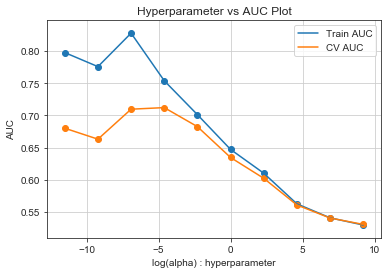

In [66]:
clf = SGDClassifier(loss='log',n_jobs=-1,class_weight='balanced')
parameters = {'alpha':np.logspace(-5,4,10)} 

gridSearchCV(clf, parameters, X_tr, y_train)

On Train Data :
              precision    recall  f1-score   support

          -1       0.96      0.81      0.88     37062
           1       0.18      0.52      0.27      2938

    accuracy                           0.79     40000
   macro avg       0.57      0.67      0.57     40000
weighted avg       0.90      0.79      0.83     40000

[[30123  6939]
 [ 1397  1541]]
0.7496473261977179
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.95      0.81      0.87      9266
           1       0.16      0.44      0.23       734

    accuracy                           0.78     10000
   macro avg       0.55      0.62      0.55     10000
weighted avg       0.89      0.78      0.83     10000

[[7513 1753]
 [ 412  322]]
0.6958659327617125


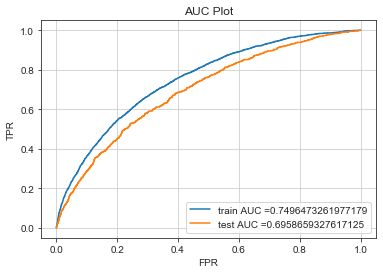

In [67]:
clf = SGDClassifier(loss='log',n_jobs=-1,class_weight='balanced',alpha=0.01).fit(X_tr,y_train)

print('On Train Data :')
print(classification_report(y_train, clf.predict(X_tr)))
print(confusion_matrix(y_train, clf.predict(X_tr)))
print(roc_auc_score(y_train, clf.predict_proba(X_tr)[:,1]))
print('-'*50)


print('On Test Data :')
print(classification_report(y_test, clf.predict(X_te)))
print(confusion_matrix(y_test, clf.predict(X_te)))
print(roc_auc_score(y_test, clf.predict_proba(X_te)[:,1]))

aucPlotter(clf, X_tr, y_train, X_te, y_test)

In [184]:
summary.add_row(['Churn','OHE',' - ','SGD log loss','0.16/0.44','0.69'])

SVM

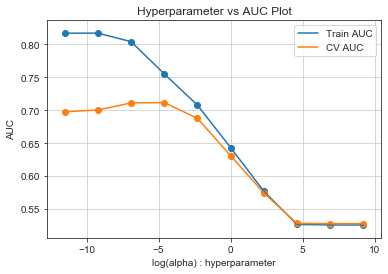

In [68]:
clf = SGDClassifier(loss='hinge',n_jobs=-1,class_weight='balanced')
parameters = {'alpha':np.logspace(-5,4,10)} 

gridSearchCV(clf, parameters, X_tr, y_train)

On Train Data :
              precision    recall  f1-score   support

          -1       0.93      1.00      0.96     37062
           1       0.20      0.00      0.00      2938

    accuracy                           0.93     40000
   macro avg       0.56      0.50      0.48     40000
weighted avg       0.87      0.93      0.89     40000

[[37058     4]
 [ 2937     1]]
0.6988695813711824
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.93      1.00      0.96      9266
           1       0.50      0.00      0.00       734

    accuracy                           0.93     10000
   macro avg       0.71      0.50      0.48     10000
weighted avg       0.90      0.93      0.89     10000

[[9265    1]
 [ 733    1]]
0.6775656041747657


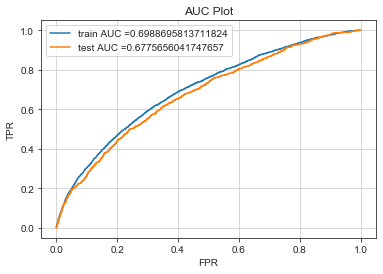

In [69]:
svc = SGDClassifier(loss='hinge',class_weight='balanced',alpha=0.1)
clf =svc.fit(X_tr, y_train)
calibrator = CalibratedClassifierCV(clf, cv='prefit')
model=calibrator.fit(X_tr, y_train)

print('On Train Data :')
print(classification_report(y_train, model.predict(X_tr)))
print(confusion_matrix(y_train, model.predict(X_tr)))
print(roc_auc_score(y_train, model.predict_proba(X_tr)[:,1]))
print('-'*50)


print('On Test Data :')
print(classification_report(y_test, model.predict(X_te)))
print(confusion_matrix(y_test, model.predict(X_te)))
print(roc_auc_score(y_test, model.predict_proba(X_te)[:,1]))

aucPlotter(model, X_tr, y_train, X_te, y_test)

In [185]:
summary.add_row(['Churn','OHE',' - ','SGD hinge loss','0.50/0.00','0.67'])

Decision Tree

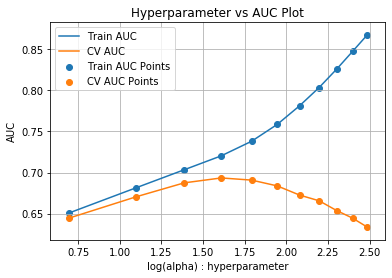

In [172]:
clf = DecisionTreeClassifier(class_weight='balanced')
parameters = {'max_depth':np.arange(2,13)} 

gridSearchCV(clf, parameters, X_tr, y_train)

On Train Data :
              precision    recall  f1-score   support

          -1       0.96      0.60      0.73     37062
           1       0.12      0.68      0.20      2938

    accuracy                           0.60     40000
   macro avg       0.54      0.64      0.47     40000
weighted avg       0.90      0.60      0.70     40000

[[22072 14990]
 [  926  2012]]
0.6840027853901759
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.96      0.60      0.74      9266
           1       0.12      0.68      0.20       734

    accuracy                           0.60     10000
   macro avg       0.54      0.64      0.47     10000
weighted avg       0.90      0.60      0.70     10000

[[5536 3730]
 [ 232  502]]
0.6703401612999034


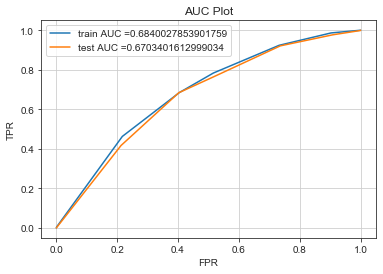

In [70]:
clf = DecisionTreeClassifier(max_depth=3,class_weight='balanced').fit(X_tr, y_train)

print('On Train Data :')
print(classification_report(y_train, clf.predict(X_tr)))
print(confusion_matrix(y_train, clf.predict(X_tr)))
print(roc_auc_score(y_train, clf.predict_proba(X_tr)[:,1]))
print('-'*50)


print('On Test Data :')
print(classification_report(y_test, clf.predict(X_te)))
print(confusion_matrix(y_test, clf.predict(X_te)))
print(roc_auc_score(y_test, clf.predict_proba(X_te)[:,1]))

aucPlotter(clf, X_tr, y_train, X_te, y_test)

In [186]:
summary.add_row(['Churn','OHE',' - ','Decision Tree','0.12/0.68','0.67'])

Random Forest

In [71]:
rfc = RandomForestClassifier(class_weight='balanced')
parameters = {'n_estimators':[3,5,10,20,50,100],'max_depth':[3,5,7,9,10,None]} 

clf = GridSearchCV(rfc, parameters, scoring='roc_auc', cv=3,n_jobs=-1,return_train_score=True )
clf.fit(X_tr, y_train)

print(clf.best_score_)
print(clf.best_params_)
results = pd.DataFrame.from_dict(clf.cv_results_)

0.6744176119298219
{'max_depth': None, 'n_estimators': 100}


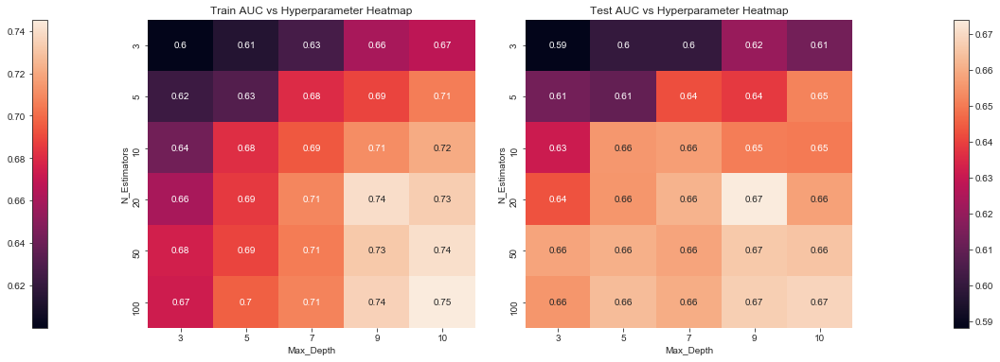

In [72]:
n_estimators = results['param_n_estimators']
max_depth = results['param_max_depth'] 
train_auc = results['mean_train_score']
test_auc = results['mean_test_score']

fig, (ax1, ax2) = plt.subplots(1,2,figsize=(20,6))

train_auc_df = pd.DataFrame({'N_Estimators': n_estimators,
                       'Max_Depth': max_depth,
                       'Train_AUC_Score': train_auc})
train_auc_pivot = train_auc_df.pivot_table(index='N_Estimators',columns='Max_Depth',values='Train_AUC_Score')

test_auc_df = pd.DataFrame({'N_Estimators': n_estimators,
                       'Max_Depth': max_depth,
                       'Test_AUC_Score': test_auc})
test_auc_pivot = test_auc_df.pivot_table(index='N_Estimators',columns='Max_Depth',values='Test_AUC_Score')

ax1.set(title = 'Train AUC vs Hyperparameter Heatmap')
ax2.set(title = 'Test AUC vs Hyperparameter Heatmap')
sns.heatmap(train_auc_pivot, annot = True, ax=ax1,cbar=False)
sns.heatmap(test_auc_pivot, annot = True, ax=ax2,cbar=False)


fig.subplots_adjust(wspace=0.1)
fig.colorbar(ax1.collections[0], ax=ax1,location="left", use_gridspec=False, pad=0.2)
fig.colorbar(ax2.collections[0], ax=ax2,location="right", use_gridspec=False, pad=0.2)
plt.show()

On Train Data :
              precision    recall  f1-score   support

          -1       1.00      1.00      1.00     37062
           1       1.00      1.00      1.00      2938

    accuracy                           1.00     40000
   macro avg       1.00      1.00      1.00     40000
weighted avg       1.00      1.00      1.00     40000

[[37062     0]
 [    2  2936]]
1.0
--------------------------------------------------
On Test Data :


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1221: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

          -1       0.93      1.00      0.96      9266
           1       0.00      0.00      0.00       734

    accuracy                           0.93     10000
   macro avg       0.46      0.50      0.48     10000
weighted avg       0.86      0.93      0.89     10000

[[9266    0]
 [ 734    0]]
0.6608121984742791


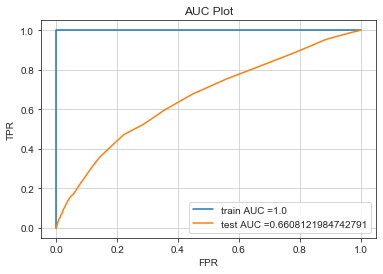

In [73]:
clf = RandomForestClassifier(class_weight='balanced',max_depth=None,n_estimators=100).fit(X_tr, y_train)

print('On Train Data :')
print(classification_report(y_train, clf.predict(X_tr)))
print(confusion_matrix(y_train, clf.predict(X_tr)))
print(roc_auc_score(y_train, clf.predict_proba(X_tr)[:,1]))
print('-'*50)


print('On Test Data :')
print(classification_report(y_test, clf.predict(X_te)))
print(confusion_matrix(y_test, clf.predict(X_te)))
print(roc_auc_score(y_test, clf.predict_proba(X_te)[:,1]))

aucPlotter(clf, X_tr, y_train, X_te, y_test)

In [187]:
summary.add_row(['Churn','OHE',' - ','Random Forest','0.00/0.00','0.66'])

XGBoost

In [74]:
params = {
        'learning_rate': [0.001, 0.05, 0.025 ,0.01, 0.1, 0.3, 0.5],
        'max_depth': [2, 3, 4, 5, 8, 10, 12],
        'n_estimators': [3, 5, 10, 15, 25, 100, 150 ,200]
        }

xgb = XGBClassifier(tree_method='hist',scale_pos_weight=12.6)

clf = RandomizedSearchCV(xgb, param_distributions=params, scoring='roc_auc', n_jobs=-1, cv=3, random_state=42, return_train_score=True)
clf.fit(X_tr, y_train)

print(clf.best_score_)
print(clf.best_params_)
results = pd.DataFrame.from_dict(clf.cv_results_)

0.7295112596897834
{'n_estimators': 150, 'max_depth': 4, 'learning_rate': 0.1}


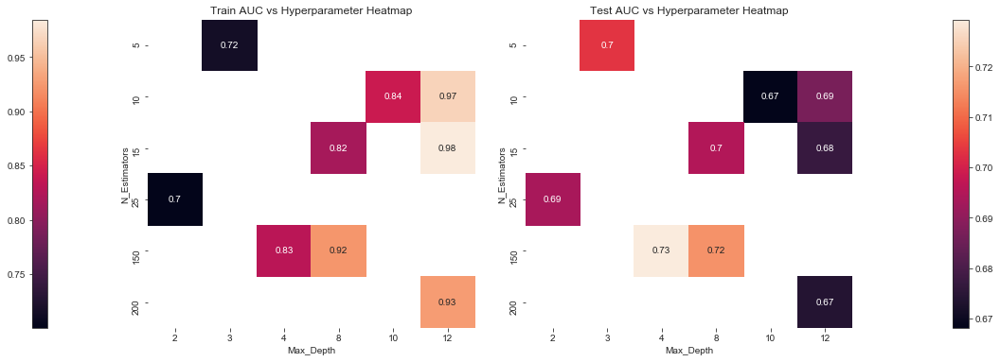

In [75]:
n_estimators = results['param_n_estimators']
max_depth = results['param_max_depth'] 
train_auc = results['mean_train_score']
test_auc = results['mean_test_score']

fig, (ax1, ax2) = plt.subplots(1,2,figsize=(20,6))

train_auc_df = pd.DataFrame({'N_Estimators': n_estimators,
                       'Max_Depth': max_depth,
                       'Train_AUC_Score': train_auc})
train_auc_pivot = train_auc_df.pivot_table(index='N_Estimators',columns='Max_Depth',values='Train_AUC_Score')

test_auc_df = pd.DataFrame({'N_Estimators': n_estimators,
                       'Max_Depth': max_depth,
                       'Test_AUC_Score': test_auc})
test_auc_pivot = test_auc_df.pivot_table(index='N_Estimators',columns='Max_Depth',values='Test_AUC_Score')

ax1.set(title = 'Train AUC vs Hyperparameter Heatmap')
ax2.set(title = 'Test AUC vs Hyperparameter Heatmap')
sns.heatmap(train_auc_pivot, annot = True, ax=ax1,cbar=False)
sns.heatmap(test_auc_pivot, annot = True, ax=ax2,cbar=False)


fig.subplots_adjust(wspace=0.1)
fig.colorbar(ax1.collections[0], ax=ax1,location="left", use_gridspec=False, pad=0.2)
fig.colorbar(ax2.collections[0], ax=ax2,location="right", use_gridspec=False, pad=0.2)
plt.show()

On Train Data :
              precision    recall  f1-score   support

          -1       0.97      0.70      0.82     37062
           1       0.16      0.71      0.26      2938

    accuracy                           0.70     40000
   macro avg       0.56      0.71      0.54     40000
weighted avg       0.91      0.70      0.77     40000

[[26108 10954]
 [  855  2083]]
0.7879878459875838
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.96      0.70      0.81      9266
           1       0.14      0.61      0.23       734

    accuracy                           0.70     10000
   macro avg       0.55      0.65      0.52     10000
weighted avg       0.90      0.70      0.77     10000

[[6511 2755]
 [ 289  445]]
0.712679106939848


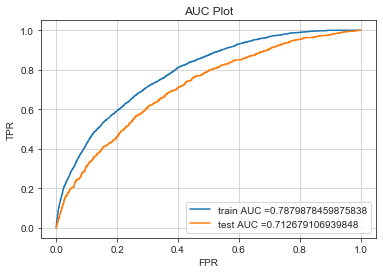

In [76]:
clf = XGBClassifier(tree_method='hist',n_estimators=200, max_depth=4, learning_rate=0.03,scale_pos_weight=12.6)
clf.fit(X_tr, y_train)

print('On Train Data :')
print(classification_report(y_train, clf.predict(X_tr)))
print(confusion_matrix(y_train, clf.predict(X_tr)))
print(roc_auc_score(y_train, clf.predict_proba(X_tr)[:,1]))
print('-'*50)


print('On Test Data :')
print(classification_report(y_test, clf.predict(X_te)))
print(confusion_matrix(y_test, clf.predict(X_te)))
print(roc_auc_score(y_test, clf.predict_proba(X_te)[:,1]))

aucPlotter(clf, X_tr, y_train, X_te, y_test)

In [188]:
summary.add_row(['Churn','OHE',' - ','XGBoost','0.14/0.61','0.71'])

<hr>

Now we will try other encoding methods on same models and compare the performance

<hr>

#### Leave One Out Encoding

Logistic Regression

On Train Data :
              precision    recall  f1-score   support

          -1       0.93      0.97      0.95     37062
           1       0.28      0.14      0.19      2938

    accuracy                           0.91     40000
   macro avg       0.61      0.56      0.57     40000
weighted avg       0.89      0.91      0.90     40000

[[35978  1084]
 [ 2521   417]]
0.7094204809566249
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.93      0.97      0.95      9266
           1       0.17      0.08      0.11       734

    accuracy                           0.90     10000
   macro avg       0.55      0.52      0.53     10000
weighted avg       0.87      0.90      0.89     10000

[[8986  280]
 [ 677   57]]
0.6121881526379586


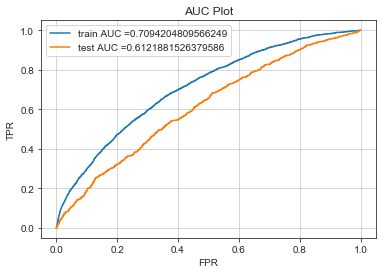

In [114]:
clf = SGDClassifier(loss='log',class_weight='balanced',alpha=0.01).fit(X_tr,y_train)

print('On Train Data :')
print(classification_report(y_train, clf.predict(X_tr)))
print(confusion_matrix(y_train, clf.predict(X_tr)))
print(roc_auc_score(y_train, clf.predict_proba(X_tr)[:,1]))
print('-'*50)


print('On Test Data :')
print(classification_report(y_test, clf.predict(X_te)))
print(confusion_matrix(y_test, clf.predict(X_te)))
print(roc_auc_score(y_test, clf.predict_proba(X_te)[:,1]))

aucPlotter(clf, X_tr, y_train, X_te, y_test)

In [189]:
summary.add_row(['Churn','Leave One Out',' - ','SGD log loss','0.17/0.08','0.61'])

SVM

On Train Data :
              precision    recall  f1-score   support

          -1       0.93      1.00      0.96     37062
           1       0.26      0.00      0.01      2938

    accuracy                           0.93     40000
   macro avg       0.59      0.50      0.48     40000
weighted avg       0.88      0.93      0.89     40000

[[37034    28]
 [ 2928    10]]
0.7098469001532177
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.93      1.00      0.96      9266
           1       0.00      0.00      0.00       734

    accuracy                           0.93     10000
   macro avg       0.46      0.50      0.48     10000
weighted avg       0.86      0.93      0.89     10000

[[9258    8]
 [ 734    0]]
0.6054379169457823


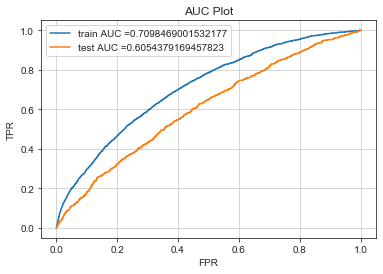

In [115]:
svc = SGDClassifier(loss='hinge',class_weight='balanced',alpha=0.01)
clf =svc.fit(X_tr, y_train)
calibrator = CalibratedClassifierCV(clf, cv='prefit')
model=calibrator.fit(X_tr, y_train)

print('On Train Data :')
print(classification_report(y_train, model.predict(X_tr)))
print(confusion_matrix(y_train, model.predict(X_tr)))
print(roc_auc_score(y_train, model.predict_proba(X_tr)[:,1]))
print('-'*50)


print('On Test Data :')
print(classification_report(y_test, model.predict(X_te)))
print(confusion_matrix(y_test, model.predict(X_te)))
print(roc_auc_score(y_test, model.predict_proba(X_te)[:,1]))

aucPlotter(model, X_tr, y_train, X_te, y_test)

In [190]:
summary.add_row(['Churn','Leave One Out',' - ','SGD hinge loss','0.00/0.00','0.60'])

Decision Tree

On Train Data :
              precision    recall  f1-score   support

          -1       0.96      0.60      0.74     37062
           1       0.12      0.68      0.20      2938

    accuracy                           0.60     40000
   macro avg       0.54      0.64      0.47     40000
weighted avg       0.90      0.60      0.70     40000

[[22079 14983]
 [  927  2011]]
0.6843263192004096
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.96      0.60      0.74      9266
           1       0.12      0.68      0.20       734

    accuracy                           0.60     10000
   macro avg       0.54      0.64      0.47     10000
weighted avg       0.90      0.60      0.70     10000

[[5525 3741]
 [ 232  502]]
0.6691096511167662


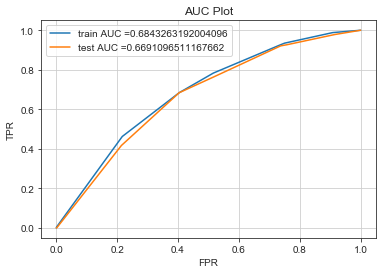

In [116]:
clf = DecisionTreeClassifier(max_depth=3,class_weight='balanced').fit(X_tr, y_train)

print('On Train Data :')
print(classification_report(y_train, clf.predict(X_tr)))
print(confusion_matrix(y_train, clf.predict(X_tr)))
print(roc_auc_score(y_train, clf.predict_proba(X_tr)[:,1]))
print('-'*50)


print('On Test Data :')
print(classification_report(y_test, clf.predict(X_te)))
print(confusion_matrix(y_test, clf.predict(X_te)))
print(roc_auc_score(y_test, clf.predict_proba(X_te)[:,1]))

aucPlotter(clf, X_tr, y_train, X_te, y_test)

In [191]:
summary.add_row(['Churn','Leave One Out',' - ','Decision Tree','0.12/0.68','0.66'])

#### Binary Encoding

Logistic Regression

On Train Data :
              precision    recall  f1-score   support

          -1       0.97      0.42      0.58     37062
           1       0.11      0.86      0.19      2938

    accuracy                           0.45     40000
   macro avg       0.54      0.64      0.39     40000
weighted avg       0.91      0.45      0.55     40000

[[15446 21616]
 [  400  2538]]
0.7298044150917571
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.97      0.40      0.56      9266
           1       0.10      0.82      0.17       734

    accuracy                           0.43     10000
   macro avg       0.53      0.61      0.37     10000
weighted avg       0.90      0.43      0.53     10000

[[3685 5581]
 [ 131  603]]
0.6884581702994335


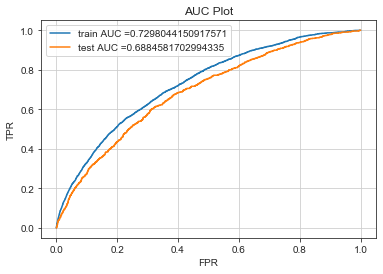

In [137]:
clf = SGDClassifier(loss='log',class_weight='balanced',alpha=0.01).fit(X_tr,y_train)

print('On Train Data :')
print(classification_report(y_train, clf.predict(X_tr)))
print(confusion_matrix(y_train, clf.predict(X_tr)))
print(roc_auc_score(y_train, clf.predict_proba(X_tr)[:,1]))
print('-'*50)


print('On Test Data :')
print(classification_report(y_test, clf.predict(X_te)))
print(confusion_matrix(y_test, clf.predict(X_te)))
print(roc_auc_score(y_test, clf.predict_proba(X_te)[:,1]))

aucPlotter(clf, X_tr, y_train, X_te, y_test)

In [192]:
summary.add_row(['Churn','Binary',' - ','SGD log loss','0.10/0.82','0.68'])

SVM

On Train Data :
              precision    recall  f1-score   support

          -1       0.93      1.00      0.96     37062
           1       0.44      0.01      0.01      2938

    accuracy                           0.93     40000
   macro avg       0.69      0.50      0.49     40000
weighted avg       0.89      0.93      0.89     40000

[[37037    25]
 [ 2918    20]]
0.7287824122946853
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.93      1.00      0.96      9266
           1       0.08      0.00      0.00       734

    accuracy                           0.93     10000
   macro avg       0.50      0.50      0.48     10000
weighted avg       0.86      0.93      0.89     10000

[[9255   11]
 [ 733    1]]
0.6871315012371266


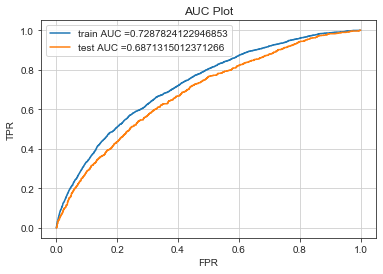

In [138]:
svc = SGDClassifier(loss='hinge',class_weight='balanced',alpha=0.01)
clf =svc.fit(X_tr, y_train)
calibrator = CalibratedClassifierCV(clf, cv='prefit')
model=calibrator.fit(X_tr, y_train)

print('On Train Data :')
print(classification_report(y_train, model.predict(X_tr)))
print(confusion_matrix(y_train, model.predict(X_tr)))
print(roc_auc_score(y_train, model.predict_proba(X_tr)[:,1]))
print('-'*50)


print('On Test Data :')
print(classification_report(y_test, model.predict(X_te)))
print(confusion_matrix(y_test, model.predict(X_te)))
print(roc_auc_score(y_test, model.predict_proba(X_te)[:,1]))

aucPlotter(model, X_tr, y_train, X_te, y_test)

In [193]:
summary.add_row(['Churn','Binary',' - ','SGD hinge loss','0.08/0.00','0.68'])

Decision Tree

On Train Data :
              precision    recall  f1-score   support

          -1       0.96      0.59      0.73     37062
           1       0.12      0.68      0.20      2938

    accuracy                           0.60     40000
   macro avg       0.54      0.64      0.47     40000
weighted avg       0.90      0.60      0.70     40000

[[22042 15020]
 [  928  2010]]
0.682790054778777
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.96      0.60      0.74      9266
           1       0.12      0.69      0.20       734

    accuracy                           0.60     10000
   macro avg       0.54      0.64      0.47     10000
weighted avg       0.90      0.60      0.70     10000

[[5529 3737]
 [ 231  503]]
0.6709363757571409


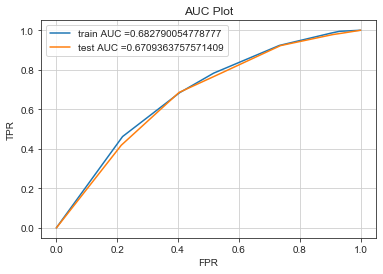

In [139]:
clf = DecisionTreeClassifier(max_depth=3,class_weight='balanced').fit(X_tr, y_train)

print('On Train Data :')
print(classification_report(y_train, clf.predict(X_tr)))
print(confusion_matrix(y_train, clf.predict(X_tr)))
print(roc_auc_score(y_train, clf.predict_proba(X_tr)[:,1]))
print('-'*50)


print('On Test Data :')
print(classification_report(y_test, clf.predict(X_te)))
print(confusion_matrix(y_test, clf.predict(X_te)))
print(roc_auc_score(y_test, clf.predict_proba(X_te)[:,1]))

aucPlotter(clf, X_tr, y_train, X_te, y_test)

In [194]:
summary.add_row(['Churn','Binary',' - ','Decision Tree','0.12/0.69','0.67'])

#### Frequency Encoding

Logistic Regression

On Train Data :
              precision    recall  f1-score   support

          -1       0.95      0.86      0.90     37062
           1       0.17      0.37      0.23      2938

    accuracy                           0.82     40000
   macro avg       0.56      0.61      0.57     40000
weighted avg       0.89      0.82      0.85     40000

[[31827  5235]
 [ 1851  1087]]
0.7067895520243727
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.94      0.86      0.90      9266
           1       0.16      0.34      0.22       734

    accuracy                           0.82     10000
   macro avg       0.55      0.60      0.56     10000
weighted avg       0.89      0.82      0.85     10000

[[7973 1293]
 [ 483  251]]
0.6840539760079185


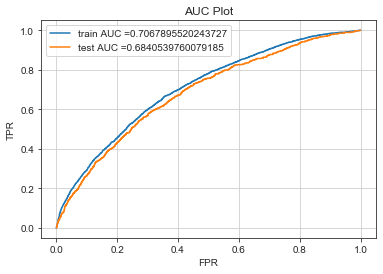

In [167]:
clf = SGDClassifier(loss='log',class_weight='balanced',alpha=0.01).fit(X_tr,y_train)

print('On Train Data :')
print(classification_report(y_train, clf.predict(X_tr)))
print(confusion_matrix(y_train, clf.predict(X_tr)))
print(roc_auc_score(y_train, clf.predict_proba(X_tr)[:,1]))
print('-'*50)


print('On Test Data :')
print(classification_report(y_test, clf.predict(X_te)))
print(confusion_matrix(y_test, clf.predict(X_te)))
print(roc_auc_score(y_test, clf.predict_proba(X_te)[:,1]))

aucPlotter(clf, X_tr, y_train, X_te, y_test)

In [195]:
summary.add_row(['Churn','Freq. Encoded',' - ','SGD with log loss','0.16/0.34','0.68'])

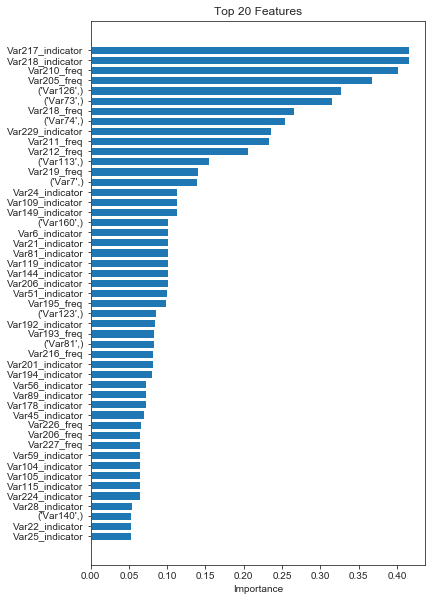

In [168]:
# plt.rcdefaults()

coef = [abs(i) for i in clf.coef_.ravel()]
feature_names = np.concatenate((X_train.columns.values, X_train_norm.columns.values))
feature_imp = dict(zip(feature_names,coef))
feature_imp = {k: v for k, v in sorted(feature_imp.items(), key=lambda item: item[1], reverse=True)}

top_20_features = {k: feature_imp[k] for k in list(feature_imp)[1:50]}

fig, ax = plt.subplots(figsize=(6,10))

people = top_20_features.keys()
y_pos = np.arange(len(people))
importance = top_20_features.values()

ax.barh(y_pos, importance,align='center')
ax.set_yticks(y_pos)
ax.set_yticklabels(people)
ax.invert_yaxis()
ax.set_xlabel('Importance')
ax.set_title('Top 20 Features')

plt.show()

Decision Tree

On Train Data :
              precision    recall  f1-score   support

          -1       0.96      0.59      0.73     37062
           1       0.12      0.69      0.20      2938

    accuracy                           0.60     40000
   macro avg       0.54      0.64      0.47     40000
weighted avg       0.90      0.60      0.69     40000

[[21983 15079]
 [  923  2015]]
0.6830236339019278
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.96      0.59      0.73      9266
           1       0.12      0.69      0.20       734

    accuracy                           0.60     10000
   macro avg       0.54      0.64      0.47     10000
weighted avg       0.90      0.60      0.70     10000

[[5508 3758]
 [ 229  505]]
0.6714853194503829


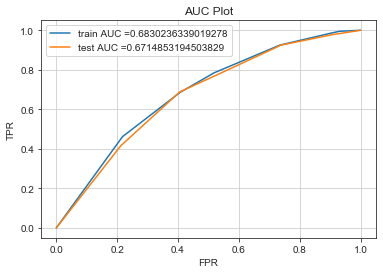

In [170]:
clf = DecisionTreeClassifier(max_depth=3,class_weight='balanced').fit(X_tr, y_train)

print('On Train Data :')
print(classification_report(y_train, clf.predict(X_tr)))
print(confusion_matrix(y_train, clf.predict(X_tr)))
print(roc_auc_score(y_train, clf.predict_proba(X_tr)[:,1]))
print('-'*50)


print('On Test Data :')
print(classification_report(y_test, clf.predict(X_te)))
print(confusion_matrix(y_test, clf.predict(X_te)))
print(roc_auc_score(y_test, clf.predict_proba(X_te)[:,1]))

aucPlotter(clf, X_tr, y_train, X_te, y_test)

In [196]:
summary.add_row(['Churn','Freq. Encoded',' - ','Decision Tree','0.12/0.69','0.67'])

XGBoost

On Train Data :
              precision    recall  f1-score   support

          -1       0.97      0.70      0.82     37062
           1       0.16      0.72      0.27      2938

    accuracy                           0.70     40000
   macro avg       0.57      0.71      0.54     40000
weighted avg       0.91      0.70      0.77     40000

[[26059 11003]
 [  808  2130]]
0.7960390200748739
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.96      0.70      0.81      9266
           1       0.14      0.63      0.23       734

    accuracy                           0.70     10000
   macro avg       0.55      0.66      0.52     10000
weighted avg       0.90      0.70      0.77     10000

[[6505 2761]
 [ 275  459]]
0.7212845914659142


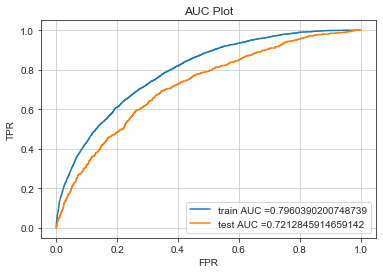

In [171]:
clf = XGBClassifier(tree_method='hist',n_estimators=200, max_depth=4, learning_rate=0.03,scale_pos_weight=12.6)
clf.fit(X_tr, y_train)

print('On Train Data :')
print(classification_report(y_train, clf.predict(X_tr)))
print(confusion_matrix(y_train, clf.predict(X_tr)))
print(roc_auc_score(y_train, clf.predict_proba(X_tr)[:,1]))
print('-'*50)


print('On Test Data :')
print(classification_report(y_test, clf.predict(X_te)))
print(confusion_matrix(y_test, clf.predict(X_te)))
print(roc_auc_score(y_test, clf.predict_proba(X_te)[:,1]))

aucPlotter(clf, X_tr, y_train, X_te, y_test)

In [197]:
summary.add_row(['Churn','Freq. Encoded',' - ','XGBoost','0.14/0.63','0.72'])

#### Results So Far

In [198]:
print(summary)

+-------+---------------+------------+-------------------+--------------------+---------+
|  Task |    Encoding   | Upsampling |     Classifier    | +ve class Prec/Rec | Auc ROC |
+-------+---------------+------------+-------------------+--------------------+---------+
| Churn |      OHE      |     -      |    SGD log loss   |     0.16/0.44      |   0.69  |
| Churn |      OHE      |     -      |   SGD hinge loss  |     0.50/0.00      |   0.67  |
| Churn |      OHE      |     -      |   Decision Tree   |     0.12/0.68      |   0.67  |
| Churn |      OHE      |     -      |   Random Forest   |     0.00/0.00      |   0.66  |
| Churn |      OHE      |     -      |      XGBoost      |     0.14/0.61      |   0.71  |
| Churn | Leave One Out |     -      |    SGD log loss   |     0.17/0.08      |   0.61  |
| Churn | Leave One Out |     -      |   SGD hinge loss  |     0.00/0.00      |   0.60  |
| Churn | Leave One Out |     -      |   Decision Tree   |     0.12/0.68      |   0.66  |
| Churn | 

### Applying SMOTE

#### One Hot Encoding

In [117]:
sm = SMOTE(sampling_strategy=0.25)

X,y = sm.fit_resample(X_tr, y_train)
print(X.shape, y.shape)

counter = Counter(y)
print(counter)

(46327, 299) (46327,)
Counter({-1: 37062, 1: 9265})


Logistic Regression

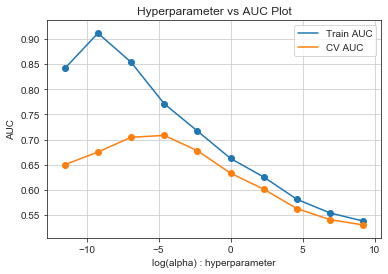

In [77]:
clf = SGDClassifier(loss='log',class_weight='balanced')
parameters = {'alpha':np.logspace(-5,4,10)} 

gridSearchCV(clf, parameters, X_tr, y_train, smote=True)

On Train Data :
              precision    recall  f1-score   support

          -1       0.89      0.74      0.81     37062
           1       0.39      0.64      0.48      9265

    accuracy                           0.72     46327
   macro avg       0.64      0.69      0.65     46327
weighted avg       0.79      0.72      0.75     46327

[[27593  9469]
 [ 3334  5931]]
0.7632730795784709
--------------------------------------------------
On non-upsampled Data :
              precision    recall  f1-score   support

          -1       0.96      0.74      0.84     37062
           1       0.16      0.61      0.25      2938

    accuracy                           0.73     40000
   macro avg       0.56      0.68      0.54     40000
weighted avg       0.90      0.73      0.80     40000

[[27593  9469]
 [ 1156  1782]]
0.7429704108498266
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.95      0.74 

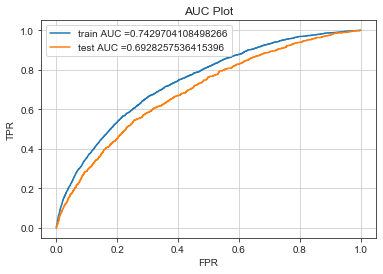

In [80]:
clf = SGDClassifier(loss='log',class_weight='balanced',alpha=0.01).fit(X,y)

print('On Train Data :')
print(classification_report(y, clf.predict(X)))
print(confusion_matrix(y, clf.predict(X)))
print(roc_auc_score(y, clf.predict_proba(X)[:,1]))
print('-'*50)

print('On non-upsampled Data :')
print(classification_report(y_train, clf.predict(X_tr)))
print(confusion_matrix(y_train, clf.predict(X_tr)))
print(roc_auc_score(y_train, clf.predict_proba(X_tr)[:,1]))
print('-'*50)

print('On Test Data :')
print(classification_report(y_test, clf.predict(X_te)))
print(confusion_matrix(y_test, clf.predict(X_te)))
print(roc_auc_score(y_test, clf.predict_proba(X_te)[:,1]))

aucPlotter(clf, X_tr, y_train, X_te, y_test)

We observe results are same after training the algorithm with synthetic points generated by SMOTE using neighbourest neighbours.

In [199]:
summary.add_row(['Churn','OHE','SMOTE','SGD log loss','0.14/0.54','0.69'])

SVM

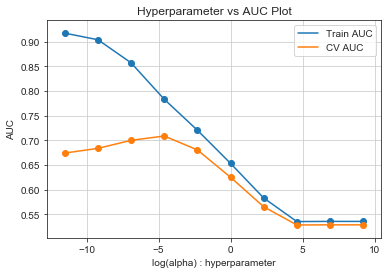

In [81]:
clf = SGDClassifier(loss='hinge',class_weight='balanced')
parameters = {'alpha':np.logspace(-5,4,10)} 

gridSearchCV(clf, parameters, X_tr, y_train, smote=True)

On Train Data :
              precision    recall  f1-score   support

          -1       0.82      0.97      0.89     37062
           1       0.56      0.17      0.26      9265

    accuracy                           0.81     46327
   macro avg       0.69      0.57      0.57     46327
weighted avg       0.77      0.81      0.76     46327

[[35855  1207]
 [ 7723  1542]]
0.7724183245338836
--------------------------------------------------
On non-upsampled Data :
              precision    recall  f1-score   support

          -1       0.93      0.97      0.95      9266
           1       0.25      0.13      0.17       734

    accuracy                           0.91     10000
   macro avg       0.59      0.55      0.56     10000
weighted avg       0.88      0.91      0.89     10000

[[8981  285]
 [ 639   95]]
0.6932897863979001
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.93      0.97     

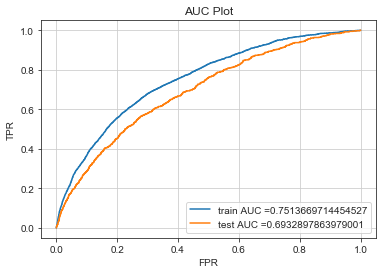

In [82]:
svc = SGDClassifier(loss='hinge',class_weight='balanced',alpha=0.01)
clf =svc.fit(X, y)
calibrator = CalibratedClassifierCV(clf, cv='prefit')
model=calibrator.fit(X, y)

print('On Train Data :')
print(classification_report(y, model.predict(X)))
print(confusion_matrix(y, model.predict(X)))
print(roc_auc_score(y, model.predict_proba(X)[:,1]))
print('-'*50)

print('On non-upsampled Data :')
print(classification_report(y_test, model.predict(X_te)))
print(confusion_matrix(y_test, model.predict(X_te)))
print(roc_auc_score(y_test, model.predict_proba(X_te)[:,1]))
print('-'*50)

print('On Test Data :')
print(classification_report(y_test, model.predict(X_te)))
print(confusion_matrix(y_test, model.predict(X_te)))
print(roc_auc_score(y_test, model.predict_proba(X_te)[:,1]))

aucPlotter(model, X_tr, y_train, X_te, y_test)

In [200]:
summary.add_row(['Churn','OHE','SMOTE','SGD hinge loss','0.25/0.13','0.69'])

Decision Tree

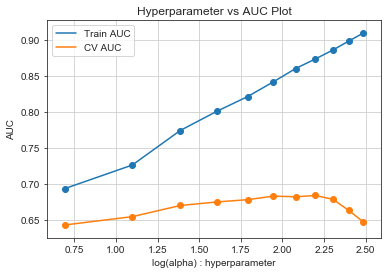

In [83]:
clf = DecisionTreeClassifier(class_weight='balanced')
parameters = {'max_depth':np.arange(2,13)} 

gridSearchCV(clf, parameters, X_tr, y_train, smote=True)

On Train Data :
              precision    recall  f1-score   support

          -1       0.91      0.59      0.71     37062
           1       0.31      0.76      0.44      9265

    accuracy                           0.62     46327
   macro avg       0.61      0.67      0.58     46327
weighted avg       0.79      0.62      0.66     46327

[[21701 15361]
 [ 2247  7018]]
0.7190020264172493
--------------------------------------------------
On non-upsampled Data :
              precision    recall  f1-score   support

          -1       0.96      0.59      0.73     37062
           1       0.11      0.66      0.19      2938

    accuracy                           0.59     40000
   macro avg       0.53      0.62      0.46     40000
weighted avg       0.89      0.59      0.69     40000

[[21701 15361]
 [ 1000  1938]]
0.6508466311065091
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.95      0.59 

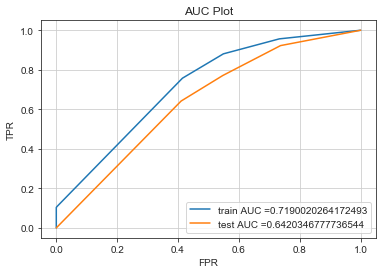

In [85]:
clf = DecisionTreeClassifier(max_depth=3,class_weight='balanced').fit(X, y)

print('On Train Data :')
print(classification_report(y, clf.predict(X)))
print(confusion_matrix(y, clf.predict(X)))
print(roc_auc_score(y, clf.predict_proba(X)[:,1]))
print('-'*50)

print('On non-upsampled Data :')
print(classification_report(y_train, clf.predict(X_tr)))
print(confusion_matrix(y_train, clf.predict(X_tr)))
print(roc_auc_score(y_train, clf.predict_proba(X_tr)[:,1]))
print('-'*50)

print('On Test Data :')
print(classification_report(y_test, clf.predict(X_te)))
print(confusion_matrix(y_test, clf.predict(X_te)))
print(roc_auc_score(y_test, clf.predict_proba(X_te)[:,1]))

aucPlotter(clf, X, y, X_te, y_test)

In [201]:
summary.add_row(['Churn','OHE','SMOTE','Decision Tree','0.11/0.64','0.64'])

Random Forest

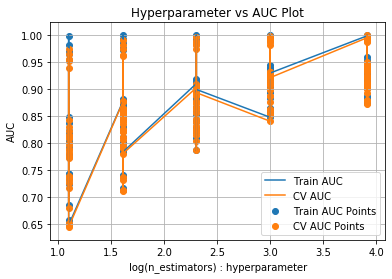

{'max_depth': None, 'min_samples_leaf': 1, 'n_estimators': 50}

In [76]:
clf = RandomForestClassifier(oob_score=True,class_weight='balanced')
parameters = {'n_estimators':[3,5,10,20,50],'max_depth':[3,5,7,9,10,None],'min_samples_leaf':[1,2,3,4,5]} 

gridSearchCV(clf, parameters, X_tr, y_train, smote=True)

On Train Data :
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     39288
           1       1.00      1.00      1.00      9822

    accuracy                           1.00     49110
   macro avg       1.00      1.00      1.00     49110
weighted avg       1.00      1.00      1.00     49110

[[39288     0]
 [    4  9818]]
1.0
--------------------------------------------------
On non-upsampled Data :
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     39288
           1       1.00      0.99      1.00       712

    accuracy                           1.00     40000
   macro avg       1.00      1.00      1.00     40000
weighted avg       1.00      1.00      1.00     40000

[[39288     0]
 [    4   708]]
1.0
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

           0       0.98      1.00      0.99      9822
          

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1221: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



[[9822    0]
 [ 178    0]]
0.6655887722814411


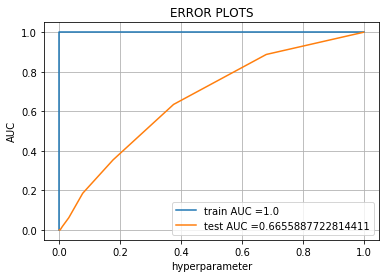

In [83]:
clf = RandomForestClassifier(max_depth=None,class_weight='balanced',min_samples_leaf=1,n_estimators=20).fit(X, y)

print('On Train Data :')
print(classification_report(y, clf.predict(X)))
print(confusion_matrix(y, clf.predict(X)))
print(roc_auc_score(y, clf.predict_proba(X)[:,1]))
print('-'*50)

print('On non-upsampled Data :')
print(classification_report(y_train, clf.predict(X_tr)))
print(confusion_matrix(y_train, clf.predict(X_tr)))
print(roc_auc_score(y_train, clf.predict_proba(X_tr)[:,1]))
print('-'*50)

print('On Test Data :')
print(classification_report(y_test, clf.predict(X_te)))
print(confusion_matrix(y_test, clf.predict(X_te)))
print(roc_auc_score(y_test, clf.predict_proba(X_te)[:,1]))

aucPlotter(clf, X_tr, y_train, X_te, y_test)

In [202]:
summary.add_row(['Churn','OHE','SMOTE','Random Forest','0.00/0.00','0.66'])

#### Leave One Out Encoding

In [180]:
sm = SMOTE(sampling_strategy=0.25)

X,y = sm.fit_resample(X_tr, y_train)
print(X.shape, y.shape)

counter = Counter(y)
print(counter)

(49110, 134) (49110,)
Counter({0: 39288, 1: 9822})


Logistic Regression

On Train Data :
              precision    recall  f1-score   support

          -1       0.91      0.51      0.65     37062
           1       0.29      0.80      0.42      9265

    accuracy                           0.56     46327
   macro avg       0.60      0.65      0.54     46327
weighted avg       0.79      0.56      0.61     46327

[[18742 18320]
 [ 1837  7428]]
0.7214861851218053
--------------------------------------------------
On non-upsampled Data :
              precision    recall  f1-score   support

          -1       0.97      0.51      0.66     37062
           1       0.11      0.77      0.19      2938

    accuracy                           0.53     40000
   macro avg       0.54      0.64      0.43     40000
weighted avg       0.90      0.53      0.63     40000

[[18742 18320]
 [  668  2270]]
0.7074570718233121
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.95      0.50 

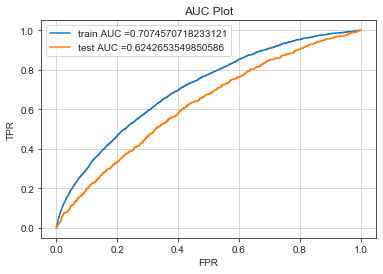

In [118]:
clf = SGDClassifier(loss='log',class_weight='balanced',alpha=0.01).fit(X,y)

print('On Train Data :')
print(classification_report(y, clf.predict(X)))
print(confusion_matrix(y, clf.predict(X)))
print(roc_auc_score(y, clf.predict_proba(X)[:,1]))
print('-'*50)

print('On non-upsampled Data :')
print(classification_report(y_train, clf.predict(X_tr)))
print(confusion_matrix(y_train, clf.predict(X_tr)))
print(roc_auc_score(y_train, clf.predict_proba(X_tr)[:,1]))
print('-'*50)

print('On Test Data :')
print(classification_report(y_test, clf.predict(X_te)))
print(confusion_matrix(y_test, clf.predict(X_te)))
print(roc_auc_score(y_test, clf.predict_proba(X_te)[:,1]))

aucPlotter(clf, X_tr, y_train, X_te, y_test)

In [203]:
summary.add_row(['Churn','Leave One Out','SMOTE','SGD log loss','0.10/0.68','0.62'])

SVM

On Train Data :
              precision    recall  f1-score   support

          -1       0.81      0.98      0.89     37062
           1       0.54      0.09      0.15      9265

    accuracy                           0.80     46327
   macro avg       0.67      0.53      0.52     46327
weighted avg       0.76      0.80      0.74     46327

[[36351   711]
 [ 8444   821]]
0.7247097125183066
--------------------------------------------------
On non-upsampled Data :
              precision    recall  f1-score   support

          -1       0.93      0.98      0.95      9266
           1       0.18      0.05      0.08       734

    accuracy                           0.91     10000
   macro avg       0.55      0.52      0.52     10000
weighted avg       0.87      0.91      0.89     10000

[[9080  186]
 [ 694   40]]
0.6186629975339805
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.93      0.98     

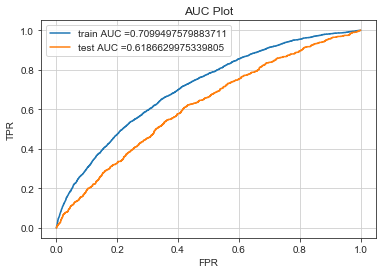

In [119]:
svc = SGDClassifier(loss='hinge',class_weight='balanced',alpha=0.01)
clf =svc.fit(X, y)
calibrator = CalibratedClassifierCV(clf, cv='prefit')
model=calibrator.fit(X, y)

print('On Train Data :')
print(classification_report(y, model.predict(X)))
print(confusion_matrix(y, model.predict(X)))
print(roc_auc_score(y, model.predict_proba(X)[:,1]))
print('-'*50)

print('On non-upsampled Data :')
print(classification_report(y_test, model.predict(X_te)))
print(confusion_matrix(y_test, model.predict(X_te)))
print(roc_auc_score(y_test, model.predict_proba(X_te)[:,1]))
print('-'*50)

print('On Test Data :')
print(classification_report(y_test, model.predict(X_te)))
print(confusion_matrix(y_test, model.predict(X_te)))
print(roc_auc_score(y_test, model.predict_proba(X_te)[:,1]))

aucPlotter(model, X_tr, y_train, X_te, y_test)

In [204]:
summary.add_row(['Churn','Leave One Out','SMOTE','SGD hinge loss','0.18/0.05','0.61'])

Decision Tree

On Train Data :
              precision    recall  f1-score   support

          -1       0.89      0.67      0.77     37062
           1       0.34      0.68      0.45      9265

    accuracy                           0.67     46327
   macro avg       0.62      0.68      0.61     46327
weighted avg       0.78      0.67      0.70     46327

[[24875 12187]
 [ 2966  6299]]
0.7377305929478652
--------------------------------------------------
On non-upsampled Data :
              precision    recall  f1-score   support

          -1       0.95      0.67      0.79     37062
           1       0.12      0.56      0.20      2938

    accuracy                           0.66     40000
   macro avg       0.53      0.61      0.49     40000
weighted avg       0.89      0.66      0.74     40000

[[24875 12187]
 [ 1300  1638]]
0.6529902343097811
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.94      0.67 

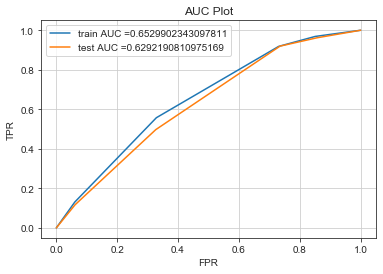

In [120]:
clf = DecisionTreeClassifier(max_depth=3,class_weight='balanced').fit(X, y)

print('On Train Data :')
print(classification_report(y, clf.predict(X)))
print(confusion_matrix(y, clf.predict(X)))
print(roc_auc_score(y, clf.predict_proba(X)[:,1]))
print('-'*50)

print('On non-upsampled Data :')
print(classification_report(y_train, clf.predict(X_tr)))
print(confusion_matrix(y_train, clf.predict(X_tr)))
print(roc_auc_score(y_train, clf.predict_proba(X_tr)[:,1]))
print('-'*50)

print('On Test Data :')
print(classification_report(y_test, clf.predict(X_te)))
print(confusion_matrix(y_test, clf.predict(X_te)))
print(roc_auc_score(y_test, clf.predict_proba(X_te)[:,1]))

aucPlotter(clf, X_tr, y_train, X_te, y_test)

In [205]:
summary.add_row(['Churn','Leave One Out','SMOTE','Decision Tree','0.11/0.50','0.62'])

#### Binary Encoding

In [140]:
sm = SMOTE(sampling_strategy=0.25)

X,y = sm.fit_resample(X_tr, y_train)
print(X.shape, y.shape)

counter = Counter(y)
print(counter)

(46327, 476) (46327,)
Counter({-1: 37062, 1: 9265})


Logistic Regression

On Train Data :
              precision    recall  f1-score   support

          -1       0.86      0.85      0.86     37062
           1       0.43      0.45      0.44      9265

    accuracy                           0.77     46327
   macro avg       0.65      0.65      0.65     46327
weighted avg       0.78      0.77      0.77     46327

[[31595  5467]
 [ 5059  4206]]
0.752656899104294
--------------------------------------------------
On non-upsampled Data :
              precision    recall  f1-score   support

          -1       0.95      0.85      0.90     37062
           1       0.18      0.42      0.26      2938

    accuracy                           0.82     40000
   macro avg       0.57      0.64      0.58     40000
weighted avg       0.89      0.82      0.85     40000

[[31595  5467]
 [ 1708  1230]]
0.7229564251230409
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.94      0.84  

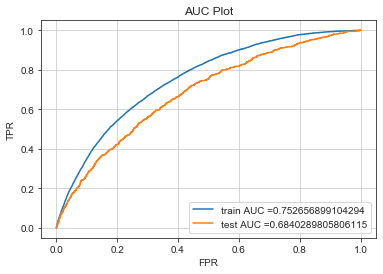

In [144]:
clf = SGDClassifier(loss='log',class_weight='balanced',alpha=0.01).fit(X,y)

print('On Train Data :')
print(classification_report(y, clf.predict(X)))
print(confusion_matrix(y, clf.predict(X)))
print(roc_auc_score(y, clf.predict_proba(X)[:,1]))
print('-'*50)

print('On non-upsampled Data :')
print(classification_report(y_train, clf.predict(X_tr)))
print(confusion_matrix(y_train, clf.predict(X_tr)))
print(roc_auc_score(y_train, clf.predict_proba(X_tr)[:,1]))
print('-'*50)

print('On Test Data :')
print(classification_report(y_test, clf.predict(X_te)))
print(confusion_matrix(y_test, clf.predict(X_te)))
print(roc_auc_score(y_test, clf.predict_proba(X_te)[:,1]))

aucPlotter(clf, X, y, X_te, y_test)

In [206]:
summary.add_row(['Churn','Binary','SMOTE','SGD log loss','0.16/0.37','0.68'])

SVM

On Train Data :
              precision    recall  f1-score   support

          -1       0.82      0.97      0.89     37062
           1       0.54      0.13      0.21      9265

    accuracy                           0.80     46327
   macro avg       0.68      0.55      0.55     46327
weighted avg       0.76      0.80      0.75     46327

[[36026  1036]
 [ 8052  1213]]
0.7544945048106113
--------------------------------------------------
On non-upsampled Data :
              precision    recall  f1-score   support

          -1       0.93      0.97      0.95      9266
           1       0.23      0.11      0.15       734

    accuracy                           0.91     10000
   macro avg       0.58      0.54      0.55     10000
weighted avg       0.88      0.91      0.89     10000

[[8997  269]
 [ 653   81]]
0.6837825550737482
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.93      0.97     

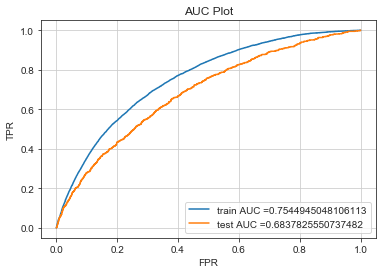

In [145]:
svc = SGDClassifier(loss='hinge',class_weight='balanced',alpha=0.01)
clf =svc.fit(X, y)
calibrator = CalibratedClassifierCV(clf, cv='prefit')
model=calibrator.fit(X, y)

print('On Train Data :')
print(classification_report(y, model.predict(X)))
print(confusion_matrix(y, model.predict(X)))
print(roc_auc_score(y, model.predict_proba(X)[:,1]))
print('-'*50)

print('On non-upsampled Data :')
print(classification_report(y_test, model.predict(X_te)))
print(confusion_matrix(y_test, model.predict(X_te)))
print(roc_auc_score(y_test, model.predict_proba(X_te)[:,1]))
print('-'*50)

print('On Test Data :')
print(classification_report(y_test, model.predict(X_te)))
print(confusion_matrix(y_test, model.predict(X_te)))
print(roc_auc_score(y_test, model.predict_proba(X_te)[:,1]))

aucPlotter(model, X, y, X_te, y_test)

In [207]:
summary.add_row(['Churn','Binary','SMOTE','SGD hinge loss','0.23/0.11','0.68'])

Decision Trees

On Train Data :
              precision    recall  f1-score   support

          -1       0.93      0.52      0.66     37062
           1       0.30      0.84      0.45      9265

    accuracy                           0.58     46327
   macro avg       0.62      0.68      0.55     46327
weighted avg       0.80      0.58      0.62     46327

[[19114 17948]
 [ 1455  7810]]
0.7524225388224333
--------------------------------------------------
On non-upsampled Data :
              precision    recall  f1-score   support

          -1       0.96      0.52      0.67     37062
           1       0.11      0.73      0.19      2938

    accuracy                           0.53     40000
   macro avg       0.53      0.63      0.43     40000
weighted avg       0.90      0.53      0.64     40000

[[19114 17948]
 [  779  2159]]
0.6523947241791843
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.96      0.51 

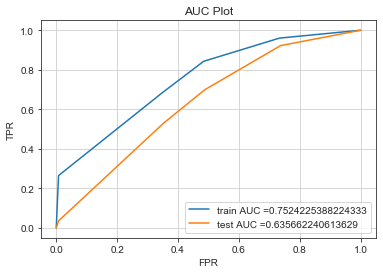

In [146]:
clf = DecisionTreeClassifier(max_depth=3,class_weight='balanced').fit(X, y)

print('On Train Data :')
print(classification_report(y, clf.predict(X)))
print(confusion_matrix(y, clf.predict(X)))
print(roc_auc_score(y, clf.predict_proba(X)[:,1]))
print('-'*50)

print('On non-upsampled Data :')
print(classification_report(y_train, clf.predict(X_tr)))
print(confusion_matrix(y_train, clf.predict(X_tr)))
print(roc_auc_score(y_train, clf.predict_proba(X_tr)[:,1]))
print('-'*50)

print('On Test Data :')
print(classification_report(y_test, clf.predict(X_te)))
print(confusion_matrix(y_test, clf.predict(X_te)))
print(roc_auc_score(y_test, clf.predict_proba(X_te)[:,1]))

aucPlotter(clf, X, y, X_te, y_test)

In [208]:
summary.add_row(['Churn','Binary','SMOTE','Decision Tree','0.10/0.70','0.63'])

#### Frequency Encoding

In [176]:
sm = SMOTE(sampling_strategy=0.25)

X,y = sm.fit_resample(X_tr, y_train)
print(X.shape, y.shape)

counter = Counter(y)
print(counter)

(46327, 299) (46327,)
Counter({-1: 37062, 1: 9265})


Logistic Regression

On Train Data :
              precision    recall  f1-score   support

          -1       0.87      0.78      0.82     37062
           1       0.37      0.53      0.44      9265

    accuracy                           0.73     46327
   macro avg       0.62      0.65      0.63     46327
weighted avg       0.77      0.73      0.74     46327

[[28892  8170]
 [ 4380  4885]]
0.7290511315718591
--------------------------------------------------
On non-upsampled Data :
              precision    recall  f1-score   support

          -1       0.94      0.78      0.85     37062
           1       0.13      0.42      0.20      2938

    accuracy                           0.75     40000
   macro avg       0.54      0.60      0.53     40000
weighted avg       0.89      0.75      0.81     40000

[[28892  8170]
 [ 1692  1246]]
0.6695911077785173
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.94      0.79 

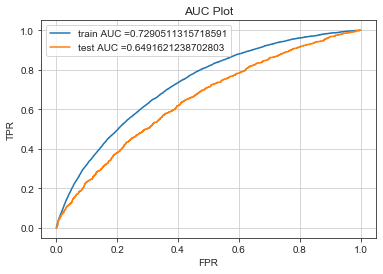

In [178]:
clf = SGDClassifier(loss='log',class_weight='balanced',alpha=0.01).fit(X,y)

print('On Train Data :')
print(classification_report(y, clf.predict(X)))
print(confusion_matrix(y, clf.predict(X)))
print(roc_auc_score(y, clf.predict_proba(X)[:,1]))
print('-'*50)

print('On non-upsampled Data :')
print(classification_report(y_train, clf.predict(X_tr)))
print(confusion_matrix(y_train, clf.predict(X_tr)))
print(roc_auc_score(y_train, clf.predict_proba(X_tr)[:,1]))
print('-'*50)

print('On Test Data :')
print(classification_report(y_test, clf.predict(X_te)))
print(confusion_matrix(y_test, clf.predict(X_te)))
print(roc_auc_score(y_test, clf.predict_proba(X_te)[:,1]))

aucPlotter(clf, X, y, X_te, y_test)

In [209]:
summary.add_row(['Churn','Freq. Encoding','SMOTE','SGD with log loss','0.13/0.40','0.64'])

Decision Tree

On Train Data :
              precision    recall  f1-score   support

          -1       0.93      0.50      0.65     37062
           1       0.30      0.86      0.44      9265

    accuracy                           0.57     46327
   macro avg       0.62      0.68      0.55     46327
weighted avg       0.81      0.57      0.61     46327

[[18403 18659]
 [ 1280  7985]]
0.7638050829078491
--------------------------------------------------
On non-upsampled Data :
              precision    recall  f1-score   support

          -1       0.96      0.50      0.66     37062
           1       0.11      0.76      0.19      2938

    accuracy                           0.52     40000
   macro avg       0.53      0.63      0.42     40000
weighted avg       0.90      0.52      0.62     40000

[[18403 18659]
 [  708  2230]]
0.6470724189690567
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.96      0.49 

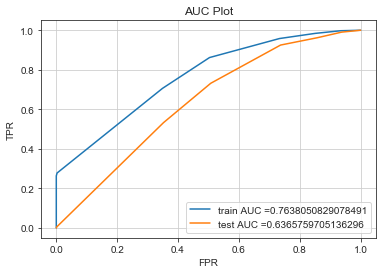

In [177]:
clf = DecisionTreeClassifier(max_depth=3,class_weight='balanced').fit(X, y)

print('On Train Data :')
print(classification_report(y, clf.predict(X)))
print(confusion_matrix(y, clf.predict(X)))
print(roc_auc_score(y, clf.predict_proba(X)[:,1]))
print('-'*50)

print('On non-upsampled Data :')
print(classification_report(y_train, clf.predict(X_tr)))
print(confusion_matrix(y_train, clf.predict(X_tr)))
print(roc_auc_score(y_train, clf.predict_proba(X_tr)[:,1]))
print('-'*50)

print('On Test Data :')
print(classification_report(y_test, clf.predict(X_te)))
print(confusion_matrix(y_test, clf.predict(X_te)))
print(roc_auc_score(y_test, clf.predict_proba(X_te)[:,1]))

aucPlotter(clf, X, y, X_te, y_test)

In [210]:
summary.add_row(['Churn','Freq. Encoding','SMOTE','Decision Tree','0.10/0.73','0.63'])

XGBoost

On Train Data :
              precision    recall  f1-score   support

          -1       0.98      0.50      0.66     37062
           1       0.32      0.95      0.48      9265

    accuracy                           0.59     46327
   macro avg       0.65      0.73      0.57     46327
weighted avg       0.85      0.59      0.63     46327

[[18614 18448]
 [  429  8836]]
0.9199830257741413
--------------------------------------------------
On non-upsampled Data :
              precision    recall  f1-score   support

          -1       0.98      0.50      0.66     37062
           1       0.12      0.86      0.21      2938

    accuracy                           0.53     40000
   macro avg       0.55      0.68      0.44     40000
weighted avg       0.92      0.53      0.63     40000

[[18614 18448]
 [  412  2526]]
0.7704531749072875
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.96      0.46 

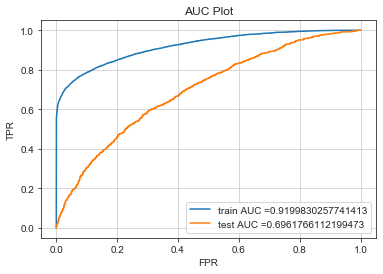

In [179]:
clf = XGBClassifier(tree_method='hist',n_estimators=200, max_depth=4, learning_rate=0.03,scale_pos_weight=12.6)
clf.fit(X, y)

print('On Train Data :')
print(classification_report(y, clf.predict(X)))
print(confusion_matrix(y, clf.predict(X)))
print(roc_auc_score(y, clf.predict_proba(X)[:,1]))
print('-'*50)

print('On non-upsampled Data :')
print(classification_report(y_train, clf.predict(X_tr)))
print(confusion_matrix(y_train, clf.predict(X_tr)))
print(roc_auc_score(y_train, clf.predict_proba(X_tr)[:,1]))
print('-'*50)

print('On Test Data :')
print(classification_report(y_test, clf.predict(X_te)))
print(confusion_matrix(y_test, clf.predict(X_te)))
print(roc_auc_score(y_test, clf.predict_proba(X_te)[:,1]))

aucPlotter(clf, X, y, X_te, y_test)

In [211]:
summary.add_row(['Churn','Freq. Encoding','SMOTE','XGBoost','0.10/0.79','0.69'])

### Applying Upsampling SMOTE and Downsampling

#### One Hot Encoding

In [87]:
over  = SMOTE(sampling_strategy=0.25)
under = RandomUnderSampler(sampling_strategy=0.3)

steps = [('o', over),('u',under)]
pipeline = Pipeline(steps=steps)

X,y = pipeline.fit_resample(X_tr, y_train)
print(X.shape, y.shape)

counter = Counter(y)
print(counter)

(40148, 24602) (40148,)
Counter({-1: 30883, 1: 9265})


Logistic Regression

On Train Data :
              precision    recall  f1-score   support

          -1       0.83      0.89      0.86     30883
           1       0.52      0.39      0.44      9265

    accuracy                           0.77     40148
   macro avg       0.67      0.64      0.65     40148
weighted avg       0.76      0.77      0.76     40148

[[27520  3363]
 [ 5687  3578]]
0.7622133212097486
--------------------------------------------------
On non-upsampled Data :
              precision    recall  f1-score   support

          -1       0.95      0.89      0.92     37062
           1       0.22      0.38      0.27      2938

    accuracy                           0.85     40000
   macro avg       0.58      0.63      0.60     40000
weighted avg       0.89      0.85      0.87     40000

[[33026  4036]
 [ 1828  1110]]
0.7410783593396513
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.94      0.89 

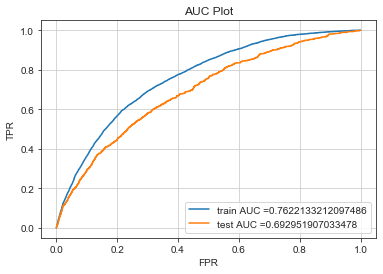

In [89]:
clf = SGDClassifier(loss='log',class_weight='balanced',alpha=0.01).fit(X,y)

print('On Train Data :')
print(classification_report(y, clf.predict(X)))
print(confusion_matrix(y, clf.predict(X)))
print(roc_auc_score(y, clf.predict_proba(X)[:,1]))
print('-'*50)

print('On non-upsampled Data :')
print(classification_report(y_train, clf.predict(X_tr)))
print(confusion_matrix(y_train, clf.predict(X_tr)))
print(roc_auc_score(y_train, clf.predict_proba(X_tr)[:,1]))
print('-'*50)

print('On Test Data :')
print(classification_report(y_test, clf.predict(X_te)))
print(confusion_matrix(y_test, clf.predict(X_te)))
print(roc_auc_score(y_test, clf.predict_proba(X_te)[:,1]))

aucPlotter(clf, X, y, X_te, y_test)

In [212]:
summary.add_row(['Churn','OHE','SMOTE + DS','SGD log loss','0.18/0.31','0.69'])

SVM

On Train Data :
              precision    recall  f1-score   support

          -1       0.80      0.95      0.87     30883
           1       0.58      0.23      0.33      9265

    accuracy                           0.78     40148
   macro avg       0.69      0.59      0.60     40148
weighted avg       0.75      0.78      0.75     40148

[[29352  1531]
 [ 7126  2139]]
0.7731812626590837
--------------------------------------------------
On non-upsampled Data :
              precision    recall  f1-score   support

          -1       0.94      0.95      0.94      9266
           1       0.23      0.18      0.20       734

    accuracy                           0.90     10000
   macro avg       0.58      0.57      0.57     10000
weighted avg       0.88      0.90      0.89     10000

[[8830  436]
 [ 604  130]]
0.6925888852098234
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.94      0.95     

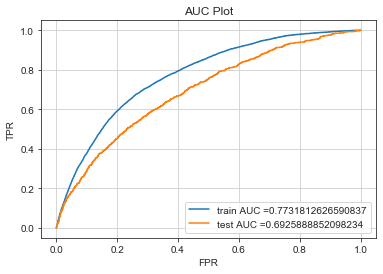

In [92]:
svc = SGDClassifier(loss='hinge',class_weight='balanced',alpha=0.01)
clf =svc.fit(X, y)
calibrator = CalibratedClassifierCV(clf, cv='prefit')
model=calibrator.fit(X, y)

print('On Train Data :')
print(classification_report(y, model.predict(X)))
print(confusion_matrix(y, model.predict(X)))
print(roc_auc_score(y, model.predict_proba(X)[:,1]))
print('-'*50)

print('On non-upsampled Data :')
print(classification_report(y_test, model.predict(X_te)))
print(confusion_matrix(y_test, model.predict(X_te)))
print(roc_auc_score(y_test, model.predict_proba(X_te)[:,1]))
print('-'*50)

print('On Test Data :')
print(classification_report(y_test, model.predict(X_te)))
print(confusion_matrix(y_test, model.predict(X_te)))
print(roc_auc_score(y_test, model.predict_proba(X_te)[:,1]))

aucPlotter(model, X, y, X_te, y_test)

In [213]:
summary.add_row(['Churn','OHE','SMOTE + DS','SGD hinge loss','0.23/0.18','0.69'])

Decision Tree

On Train Data :
              precision    recall  f1-score   support

          -1       0.89      0.58      0.71     30883
           1       0.35      0.76      0.48      9265

    accuracy                           0.62     40148
   macro avg       0.62      0.67      0.59     40148
weighted avg       0.77      0.62      0.65     40148

[[18061 12822]
 [ 2242  7023]]
0.7190297699136019
--------------------------------------------------
On non-upsampled Data :
              precision    recall  f1-score   support

          -1       0.96      0.59      0.73     37062
           1       0.11      0.66      0.19      2938

    accuracy                           0.59     40000
   macro avg       0.53      0.62      0.46     40000
weighted avg       0.89      0.59      0.69     40000

[[21701 15361]
 [ 1000  1938]]
0.6508466311065091
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.95      0.59 

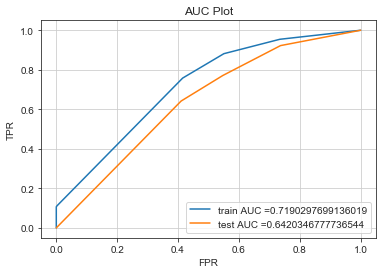

In [93]:
clf = DecisionTreeClassifier(max_depth=3,class_weight='balanced').fit(X, y)

print('On Train Data :')
print(classification_report(y, clf.predict(X)))
print(confusion_matrix(y, clf.predict(X)))
print(roc_auc_score(y, clf.predict_proba(X)[:,1]))
print('-'*50)

print('On non-upsampled Data :')
print(classification_report(y_train, clf.predict(X_tr)))
print(confusion_matrix(y_train, clf.predict(X_tr)))
print(roc_auc_score(y_train, clf.predict_proba(X_tr)[:,1]))
print('-'*50)

print('On Test Data :')
print(classification_report(y_test, clf.predict(X_te)))
print(confusion_matrix(y_test, clf.predict(X_te)))
print(roc_auc_score(y_test, clf.predict_proba(X_te)[:,1]))

aucPlotter(clf, X, y, X_te, y_test)

In [214]:
summary.add_row(['Churn','OHE','SMOTE + DS','Decision Tree','0.11/0.64','0.64'])

#### Leave One Out Encoding

In [121]:
over  = SMOTE(sampling_strategy=0.25)
under = RandomUnderSampler(sampling_strategy=0.3)

steps = [('o', over),('u',under)]
pipeline = Pipeline(steps=steps)

X,y = pipeline.fit_resample(X_tr, y_train)
print(X.shape, y.shape)

counter = Counter(y)
print(counter)

(40148, 299) (40148,)
Counter({-1: 30883, 1: 9265})


Logistic Regression

On Train Data :
              precision    recall  f1-score   support

          -1       0.86      0.70      0.77     30883
           1       0.38      0.62      0.47      9265

    accuracy                           0.68     40148
   macro avg       0.62      0.66      0.62     40148
weighted avg       0.75      0.68      0.70     40148

[[21540  9343]
 [ 3485  5780]]
0.7226589695394586
--------------------------------------------------
On non-upsampled Data :
              precision    recall  f1-score   support

          -1       0.96      0.70      0.81     37062
           1       0.13      0.59      0.22      2938

    accuracy                           0.69     40000
   macro avg       0.54      0.64      0.51     40000
weighted avg       0.90      0.69      0.76     40000

[[25814 11248]
 [ 1204  1734]]
0.7052718479317438
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.94      0.69 

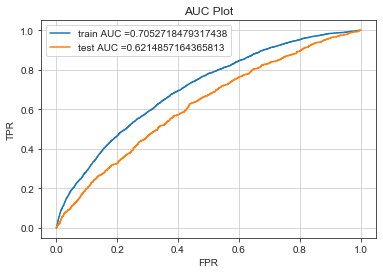

In [122]:
clf = SGDClassifier(loss='log',class_weight='balanced',alpha=0.01).fit(X,y)

print('On Train Data :')
print(classification_report(y, clf.predict(X)))
print(confusion_matrix(y, clf.predict(X)))
print(roc_auc_score(y, clf.predict_proba(X)[:,1]))
print('-'*50)

print('On non-upsampled Data :')
print(classification_report(y_train, clf.predict(X_tr)))
print(confusion_matrix(y_train, clf.predict(X_tr)))
print(roc_auc_score(y_train, clf.predict_proba(X_tr)[:,1]))
print('-'*50)

print('On Test Data :')
print(classification_report(y_test, clf.predict(X_te)))
print(confusion_matrix(y_test, clf.predict(X_te)))
print(roc_auc_score(y_test, clf.predict_proba(X_te)[:,1]))

aucPlotter(clf, X_tr, y_train, X_te, y_test)

In [215]:
summary.add_row(['Churn','Leave One Out','SMOTE + DS','SGD log loss','0.11/0.47','0.62'])

SVM

On Train Data :
              precision    recall  f1-score   support

          -1       0.79      0.97      0.87     30883
           1       0.55      0.13      0.22      9265

    accuracy                           0.77     40148
   macro avg       0.67      0.55      0.54     40148
weighted avg       0.73      0.77      0.72     40148

[[29855  1028]
 [ 8021  1244]]
0.7260382504174356
--------------------------------------------------
On non-upsampled Data :
              precision    recall  f1-score   support

          -1       0.93      0.97      0.95      9266
           1       0.16      0.08      0.10       734

    accuracy                           0.90     10000
   macro avg       0.54      0.52      0.53     10000
weighted avg       0.87      0.90      0.89     10000

[[8952  314]
 [ 676   58]]
0.6215981958594634
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.93      0.97     

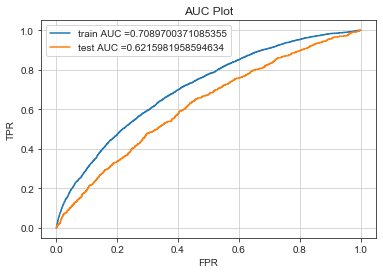

In [123]:
svc = SGDClassifier(loss='hinge',class_weight='balanced',alpha=0.01)
clf =svc.fit(X, y)
calibrator = CalibratedClassifierCV(clf, cv='prefit')
model=calibrator.fit(X, y)

print('On Train Data :')
print(classification_report(y, model.predict(X)))
print(confusion_matrix(y, model.predict(X)))
print(roc_auc_score(y, model.predict_proba(X)[:,1]))
print('-'*50)

print('On non-upsampled Data :')
print(classification_report(y_test, model.predict(X_te)))
print(confusion_matrix(y_test, model.predict(X_te)))
print(roc_auc_score(y_test, model.predict_proba(X_te)[:,1]))
print('-'*50)

print('On Test Data :')
print(classification_report(y_test, model.predict(X_te)))
print(confusion_matrix(y_test, model.predict(X_te)))
print(roc_auc_score(y_test, model.predict_proba(X_te)[:,1]))

aucPlotter(model, X_tr, y_train, X_te, y_test)

In [216]:
summary.add_row(['Churn','Leave One Out','SMOTE + DS','SGD hinge loss','0.16/0.08','0.62'])

Decision Tree

On Train Data :
              precision    recall  f1-score   support

          -1       0.88      0.67      0.76     30883
           1       0.38      0.69      0.49      9265

    accuracy                           0.67     40148
   macro avg       0.63      0.68      0.63     40148
weighted avg       0.76      0.67      0.70     40148

[[20701 10182]
 [ 2899  6366]]
0.7415891172503001
--------------------------------------------------
On non-upsampled Data :
              precision    recall  f1-score   support

          -1       0.95      0.67      0.79     37062
           1       0.12      0.56      0.20      2938

    accuracy                           0.66     40000
   macro avg       0.53      0.61      0.49     40000
weighted avg       0.89      0.66      0.74     40000

[[24875 12187]
 [ 1300  1638]]
0.6531290923872382
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.94      0.67 

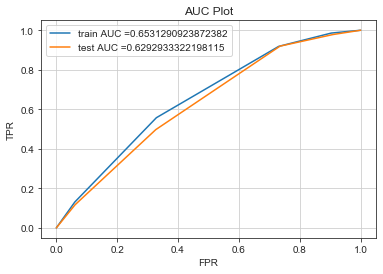

In [124]:
clf = DecisionTreeClassifier(max_depth=3,class_weight='balanced').fit(X, y)

print('On Train Data :')
print(classification_report(y, clf.predict(X)))
print(confusion_matrix(y, clf.predict(X)))
print(roc_auc_score(y, clf.predict_proba(X)[:,1]))
print('-'*50)

print('On non-upsampled Data :')
print(classification_report(y_train, clf.predict(X_tr)))
print(confusion_matrix(y_train, clf.predict(X_tr)))
print(roc_auc_score(y_train, clf.predict_proba(X_tr)[:,1]))
print('-'*50)

print('On Test Data :')
print(classification_report(y_test, clf.predict(X_te)))
print(confusion_matrix(y_test, clf.predict(X_te)))
print(roc_auc_score(y_test, clf.predict_proba(X_te)[:,1]))

aucPlotter(clf, X_tr, y_train, X_te, y_test)

In [217]:
summary.add_row(['Churn','Leave One Out','SMOTE + DS','Decision Tree','0.11/0.50','0.62'])

#### Binary Encoding

In [147]:
over  = SMOTE(sampling_strategy=0.25)
under = RandomUnderSampler(sampling_strategy=0.3)

steps = [('o', over),('u',under)]
pipeline = Pipeline(steps=steps)

X,y = pipeline.fit_resample(X_tr, y_train)
print(X.shape, y.shape)

counter = Counter(y)
print(counter)

(40148, 476) (40148,)
Counter({-1: 30883, 1: 9265})


Logistic Regression

On Train Data :
              precision    recall  f1-score   support

          -1       0.83      0.88      0.85     30883
           1       0.49      0.39      0.43      9265

    accuracy                           0.76     40148
   macro avg       0.66      0.63      0.64     40148
weighted avg       0.75      0.76      0.75     40148

[[27120  3763]
 [ 5678  3587]]
0.7495709683601386
--------------------------------------------------
On non-upsampled Data :
              precision    recall  f1-score   support

          -1       0.95      0.88      0.91     37062
           1       0.19      0.37      0.26      2938

    accuracy                           0.84     40000
   macro avg       0.57      0.62      0.58     40000
weighted avg       0.89      0.84      0.86     40000

[[32549  4513]
 [ 1849  1089]]
0.7216144426212893
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.94      0.87 

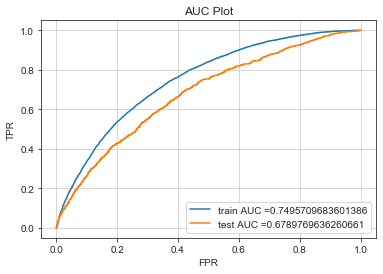

In [148]:
clf = SGDClassifier(loss='log',class_weight='balanced',alpha=0.01).fit(X,y)

print('On Train Data :')
print(classification_report(y, clf.predict(X)))
print(confusion_matrix(y, clf.predict(X)))
print(roc_auc_score(y, clf.predict_proba(X)[:,1]))
print('-'*50)

print('On non-upsampled Data :')
print(classification_report(y_train, clf.predict(X_tr)))
print(confusion_matrix(y_train, clf.predict(X_tr)))
print(roc_auc_score(y_train, clf.predict_proba(X_tr)[:,1]))
print('-'*50)

print('On Test Data :')
print(classification_report(y_test, clf.predict(X_te)))
print(confusion_matrix(y_test, clf.predict(X_te)))
print(roc_auc_score(y_test, clf.predict_proba(X_te)[:,1]))

aucPlotter(clf, X, y, X_te, y_test)

In [218]:
summary.add_row(['Churn','Binary','SMOTE + DS','SGD log loss','0.16/0.32','0.67'])

SVM

On Train Data :
              precision    recall  f1-score   support

          -1       0.80      0.96      0.87     30883
           1       0.57      0.18      0.28      9265

    accuracy                           0.78     40148
   macro avg       0.68      0.57      0.57     40148
weighted avg       0.74      0.78      0.73     40148

[[29622  1261]
 [ 7580  1685]]
0.7508044523453322
--------------------------------------------------
On non-upsampled Data :
              precision    recall  f1-score   support

          -1       0.93      0.96      0.95      9266
           1       0.22      0.15      0.18       734

    accuracy                           0.90     10000
   macro avg       0.58      0.55      0.56     10000
weighted avg       0.88      0.90      0.89     10000

[[8869  397]
 [ 624  110]]
0.6802395267689264
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.93      0.96     

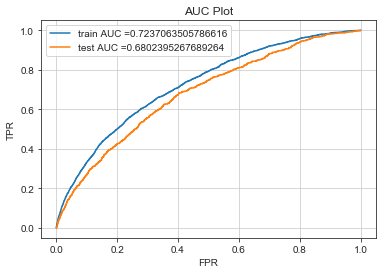

In [149]:
svc = SGDClassifier(loss='hinge',class_weight='balanced',alpha=0.01)
clf =svc.fit(X, y)
calibrator = CalibratedClassifierCV(clf, cv='prefit')
model=calibrator.fit(X, y)

print('On Train Data :')
print(classification_report(y, model.predict(X)))
print(confusion_matrix(y, model.predict(X)))
print(roc_auc_score(y, model.predict_proba(X)[:,1]))
print('-'*50)

print('On non-upsampled Data :')
print(classification_report(y_test, model.predict(X_te)))
print(confusion_matrix(y_test, model.predict(X_te)))
print(roc_auc_score(y_test, model.predict_proba(X_te)[:,1]))
print('-'*50)

print('On Test Data :')
print(classification_report(y_test, model.predict(X_te)))
print(confusion_matrix(y_test, model.predict(X_te)))
print(roc_auc_score(y_test, model.predict_proba(X_te)[:,1]))

aucPlotter(model, X_tr, y_train, X_te, y_test)

In [219]:
summary.add_row(['Churn','Binary','SMOTE + DS','SGD hinge loss','0.22/0.15','0.68'])

Decision Tree

On Train Data :
              precision    recall  f1-score   support

          -1       0.92      0.52      0.66     30883
           1       0.34      0.84      0.49      9265

    accuracy                           0.59     40148
   macro avg       0.63      0.68      0.57     40148
weighted avg       0.78      0.59      0.62     40148

[[15917 14966]
 [ 1454  7811]]
0.7535956476857741
--------------------------------------------------
On non-upsampled Data :
              precision    recall  f1-score   support

          -1       0.96      0.52      0.67     37062
           1       0.11      0.73      0.19      2938

    accuracy                           0.53     40000
   macro avg       0.53      0.63      0.43     40000
weighted avg       0.90      0.53      0.64     40000

[[19114 17948]
 [  779  2159]]
0.6523947241791843
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.96      0.51 

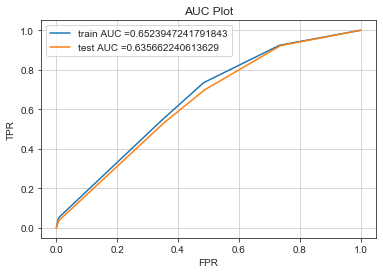

In [150]:
clf = DecisionTreeClassifier(max_depth=3,class_weight='balanced').fit(X, y)

print('On Train Data :')
print(classification_report(y, clf.predict(X)))
print(confusion_matrix(y, clf.predict(X)))
print(roc_auc_score(y, clf.predict_proba(X)[:,1]))
print('-'*50)

print('On non-upsampled Data :')
print(classification_report(y_train, clf.predict(X_tr)))
print(confusion_matrix(y_train, clf.predict(X_tr)))
print(roc_auc_score(y_train, clf.predict_proba(X_tr)[:,1]))
print('-'*50)

print('On Test Data :')
print(classification_report(y_test, clf.predict(X_te)))
print(confusion_matrix(y_test, clf.predict(X_te)))
print(roc_auc_score(y_test, clf.predict_proba(X_te)[:,1]))

aucPlotter(clf, X_tr, y_train, X_te, y_test)

In [220]:
summary.add_row(['Churn','Binary','SMOTE + DS','Decision Tree','0.10/0.70','0.63'])

#### Frequency Encoding

In [180]:
over  = SMOTE(sampling_strategy=0.25)
under = RandomUnderSampler(sampling_strategy=0.3)

steps = [('o', over),('u',under)]
pipeline = Pipeline(steps=steps)

X,y = pipeline.fit_resample(X_tr, y_train)
print(X.shape, y.shape)

counter = Counter(y)
print(counter)

(40148, 299) (40148,)
Counter({-1: 30883, 1: 9265})


Logistic Regression

On Train Data :
              precision    recall  f1-score   support

          -1       0.86      0.71      0.78     30883
           1       0.39      0.61      0.48      9265

    accuracy                           0.69     40148
   macro avg       0.62      0.66      0.63     40148
weighted avg       0.75      0.69      0.71     40148

[[21980  8903]
 [ 3583  5682]]
0.7307415053024926
--------------------------------------------------
On non-upsampled Data :
              precision    recall  f1-score   support

          -1       0.95      0.71      0.81     37062
           1       0.12      0.51      0.20      2938

    accuracy                           0.70     40000
   macro avg       0.54      0.61      0.51     40000
weighted avg       0.89      0.70      0.77     40000

[[26373 10689]
 [ 1432  1506]]
0.6726509814345648
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.95      0.72 

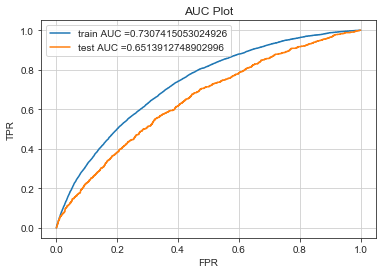

In [181]:
clf = SGDClassifier(loss='log',class_weight='balanced',alpha=0.01).fit(X,y)

print('On Train Data :')
print(classification_report(y, clf.predict(X)))
print(confusion_matrix(y, clf.predict(X)))
print(roc_auc_score(y, clf.predict_proba(X)[:,1]))
print('-'*50)

print('On non-upsampled Data :')
print(classification_report(y_train, clf.predict(X_tr)))
print(confusion_matrix(y_train, clf.predict(X_tr)))
print(roc_auc_score(y_train, clf.predict_proba(X_tr)[:,1]))
print('-'*50)

print('On Test Data :')
print(classification_report(y_test, clf.predict(X_te)))
print(confusion_matrix(y_test, clf.predict(X_te)))
print(roc_auc_score(y_test, clf.predict_proba(X_te)[:,1]))

aucPlotter(clf, X, y, X_te, y_test)

In [221]:
summary.add_row(['Churn','Freq. Encoding','SMOTE + DS','SGD with log loss','0.12/0.50','0.65'])

Decision Tree

On Train Data :
              precision    recall  f1-score   support

          -1       0.88      0.65      0.75     30883
           1       0.38      0.70      0.49      9265

    accuracy                           0.66     40148
   macro avg       0.63      0.68      0.62     40148
weighted avg       0.76      0.66      0.69     40148

[[20155 10728]
 [ 2780  6485]]
0.7600307719196936
--------------------------------------------------
On non-upsampled Data :
              precision    recall  f1-score   support

          -1       0.95      0.65      0.77     37062
           1       0.11      0.54      0.18      2938

    accuracy                           0.65     40000
   macro avg       0.53      0.60      0.48     40000
weighted avg       0.89      0.65      0.73     40000

[[24233 12829]
 [ 1345  1593]]
0.6481632722295343
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.95      0.65 

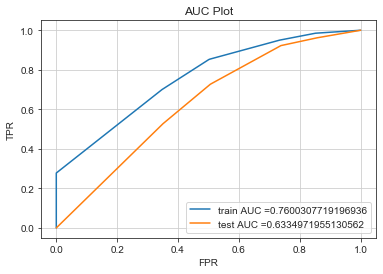

In [182]:
clf = DecisionTreeClassifier(max_depth=3,class_weight='balanced').fit(X, y)

print('On Train Data :')
print(classification_report(y, clf.predict(X)))
print(confusion_matrix(y, clf.predict(X)))
print(roc_auc_score(y, clf.predict_proba(X)[:,1]))
print('-'*50)

print('On non-upsampled Data :')
print(classification_report(y_train, clf.predict(X_tr)))
print(confusion_matrix(y_train, clf.predict(X_tr)))
print(roc_auc_score(y_train, clf.predict_proba(X_tr)[:,1]))
print('-'*50)

print('On Test Data :')
print(classification_report(y_test, clf.predict(X_te)))
print(confusion_matrix(y_test, clf.predict(X_te)))
print(roc_auc_score(y_test, clf.predict_proba(X_te)[:,1]))

aucPlotter(clf, X, y, X_te, y_test)

In [222]:
summary.add_row(['Churn','Freq. Encoding','SMOTE + DS','Decision Tree','0.11/0.53','0.63'])

XGBoost

On Train Data :
              precision    recall  f1-score   support

          -1       0.98      0.43      0.60     30883
           1       0.34      0.97      0.50      9265

    accuracy                           0.55     40148
   macro avg       0.66      0.70      0.55     40148
weighted avg       0.83      0.55      0.58     40148

[[13269 17614]
 [  282  8983]]
0.9200929315609446
--------------------------------------------------
On non-upsampled Data :
              precision    recall  f1-score   support

          -1       0.98      0.43      0.60     37062
           1       0.11      0.91      0.20      2938

    accuracy                           0.46     40000
   macro avg       0.55      0.67      0.40     40000
weighted avg       0.92      0.46      0.57     40000

[[15859 21203]
 [  270  2668]]
0.7715742288812384
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.97      0.40 

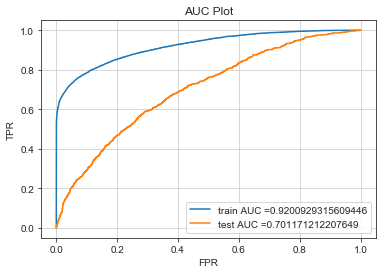

In [183]:
clf = XGBClassifier(tree_method='hist',n_estimators=200, max_depth=4, learning_rate=0.03,scale_pos_weight=12.6)
clf.fit(X, y)

print('On Train Data :')
print(classification_report(y, clf.predict(X)))
print(confusion_matrix(y, clf.predict(X)))
print(roc_auc_score(y, clf.predict_proba(X)[:,1]))
print('-'*50)

print('On non-upsampled Data :')
print(classification_report(y_train, clf.predict(X_tr)))
print(confusion_matrix(y_train, clf.predict(X_tr)))
print(roc_auc_score(y_train, clf.predict_proba(X_tr)[:,1]))
print('-'*50)

print('On Test Data :')
print(classification_report(y_test, clf.predict(X_te)))
print(confusion_matrix(y_test, clf.predict(X_te)))
print(roc_auc_score(y_test, clf.predict_proba(X_te)[:,1]))

aucPlotter(clf, X, y, X_te, y_test)

In [223]:
summary.add_row(['Churn','Freq. Encoding','SMOTE + DS','XGBoost','0.10/0.83','0.70'])

#### Results so far

In [231]:
print(summary)

+------------+----------------+------------+-------------------+--------------------+---------+
|    Task    |    Encoding    | Upsampling |     Classifier    | +ve class Prec/Rec | Auc ROC |
+------------+----------------+------------+-------------------+--------------------+---------+
|   Churn    |      OHE       |     -      |    SGD log loss   |     0.16/0.44      |   0.69  |
|   Churn    |      OHE       |     -      |   SGD hinge loss  |     0.50/0.00      |   0.67  |
|   Churn    |      OHE       |     -      |   Decision Tree   |     0.12/0.68      |   0.67  |
|   Churn    |      OHE       |     -      |   Random Forest   |     0.00/0.00      |   0.66  |
|   Churn    |      OHE       |     -      |      XGBoost      |     0.14/0.61      |   0.71  |
|   Churn    | Leave One Out  |     -      |    SGD log loss   |     0.17/0.08      |   0.61  |
|   Churn    | Leave One Out  |     -      |   SGD hinge loss  |     0.00/0.00      |   0.60  |
|   Churn    | Leave One Out  |     -   

<hr>

#### Hyperparameter tuning SMOTE

In [62]:
# Code taken from https://machinelearningmastery.com/smote-oversampling-for-imbalanced-classification/

from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedStratifiedKFold

k_values = [1, 2, 3, 4, 5, 6, 7, 8]

model = LogisticRegression()

for k in k_values:
    over  = SMOTE(sampling_strategy=0.25, k_neighbors=k)
    under = RandomUnderSampler(sampling_strategy=0.3)

    steps = [('o', over),('u',under),('m',model)]
    pipeline = Pipeline(steps=steps)
    
    # evaluate pipeline
    cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
    scores = cross_val_score(pipeline, X_tr, y_train, scoring='roc_auc', cv=cv, n_jobs=-1)
    score = np.mean(scores)
    print('> k=%d, Mean ROC AUC: %.3f' % (k, score))

> k=1, Mean ROC AUC: 0.736
> k=2, Mean ROC AUC: 0.737
> k=3, Mean ROC AUC: 0.737
> k=4, Mean ROC AUC: 0.737
> k=5, Mean ROC AUC: 0.738
> k=6, Mean ROC AUC: 0.736
> k=7, Mean ROC AUC: 0.737
> k=8, Mean ROC AUC: 0.738


#### Adaptive Synthetic Sampling Approach

In [226]:
from imblearn.over_sampling import ADASYN

oversample = ADASYN()
X, y = oversample.fit_resample(X_tr, y_train)

On Upsampled Data :
              precision    recall  f1-score   support

          -1       0.64      0.79      0.70     37062
           1       0.72      0.56      0.63     37087

    accuracy                           0.67     74149
   macro avg       0.68      0.67      0.67     74149
weighted avg       0.68      0.67      0.67     74149

[[29126  7936]
 [16482 20605]]
0.7509264463142572
--------------------------------------------------
On non-upsampled Data :
              precision    recall  f1-score   support

          -1       0.94      0.79      0.86     37062
           1       0.12      0.37      0.18      2938

    accuracy                           0.76     40000
   macro avg       0.53      0.58      0.52     40000
weighted avg       0.88      0.76      0.81     40000

[[29126  7936]
 [ 1850  1088]]
0.642192021325074
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.94      0.

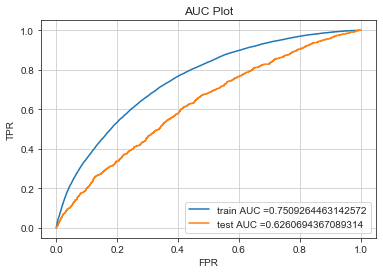

In [227]:
clf = SGDClassifier(loss='log',class_weight='balanced',alpha=0.01).fit(X,y)

print('On Upsampled Data :')
print(classification_report(y, clf.predict(X)))
print(confusion_matrix(y, clf.predict(X)))
print(roc_auc_score(y, clf.predict_proba(X)[:,1]))
print('-'*50)

print('On non-upsampled Data :')
print(classification_report(y_train, clf.predict(X_tr)))
print(confusion_matrix(y_train, clf.predict(X_tr)))
print(roc_auc_score(y_train, clf.predict_proba(X_tr)[:,1]))
print('-'*50)


print('On Test Data :')
print(classification_report(y_test, clf.predict(X_te)))
print(confusion_matrix(y_test, clf.predict(X_te)))
print(roc_auc_score(y_test, clf.predict_proba(X_te)[:,1]))

aucPlotter(clf, X, y, X_te, y_test)

In [229]:
summary.add_row(['Churn','Freq. Encoding','ASMOTE','SGD with log loss','0.12/0.35','0.62'])

XGBoost

On Train Data :
              precision    recall  f1-score   support

          -1       0.98      0.32      0.48     37062
           1       0.59      1.00      0.74     37087

    accuracy                           0.66     74149
   macro avg       0.79      0.66      0.61     74149
weighted avg       0.79      0.66      0.61     74149

[[11705 25357]
 [  185 36902]]
0.9745217520166558
--------------------------------------------------
On non-upsampled Data :
              precision    recall  f1-score   support

          -1       0.98      0.32      0.48     37062
           1       0.10      0.94      0.18      2938

    accuracy                           0.36     40000
   macro avg       0.54      0.63      0.33     40000
weighted avg       0.92      0.36      0.46     40000

[[11705 25357]
 [  179  2759]]
0.7423184712577924
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.97      0.29 

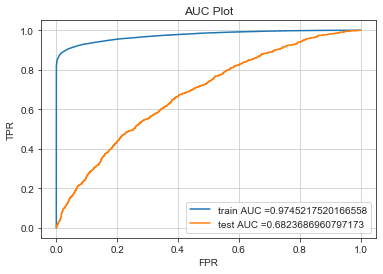

In [228]:
clf = XGBClassifier(tree_method='hist',n_estimators=200, max_depth=4, learning_rate=0.03,scale_pos_weight=12.6)
clf.fit(X, y)

print('On Train Data :')
print(classification_report(y, clf.predict(X)))
print(confusion_matrix(y, clf.predict(X)))
print(roc_auc_score(y, clf.predict_proba(X)[:,1]))
print('-'*50)

print('On non-upsampled Data :')
print(classification_report(y_train, clf.predict(X_tr)))
print(confusion_matrix(y_train, clf.predict(X_tr)))
print(roc_auc_score(y_train, clf.predict_proba(X_tr)[:,1]))
print('-'*50)

print('On Test Data :')
print(classification_report(y_test, clf.predict(X_te)))
print(confusion_matrix(y_test, clf.predict(X_te)))
print(roc_auc_score(y_test, clf.predict_proba(X_te)[:,1]))

aucPlotter(clf, X, y, X_te, y_test)

In [230]:
summary.add_row(['Churn','Freq. Encoding','ASMOTE','XGBoost','0.09/0.89','0.68'])

## Feature Engineering

#### We have already added missing value indictor features, now we will experiment with decision tree and K-Means features

On Train Data :
              precision    recall  f1-score   support

          -1       0.96      0.59      0.73     37062
           1       0.12      0.69      0.20      2938

    accuracy                           0.60     40000
   macro avg       0.54      0.64      0.47     40000
weighted avg       0.90      0.60      0.69     40000

[[21983 15079]
 [  923  2015]]
0.6830236339019278
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.96      0.59      0.73      9266
           1       0.12      0.69      0.20       734

    accuracy                           0.60     10000
   macro avg       0.54      0.64      0.47     10000
weighted avg       0.90      0.60      0.70     10000

[[5508 3758]
 [ 229  505]]
0.6714853194503829


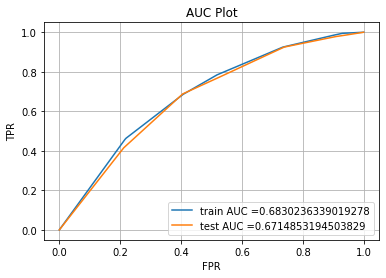

In [57]:
clf = DecisionTreeClassifier(max_depth=3,class_weight='balanced').fit(X_tr, y_train)

print('On Train Data :')
print(classification_report(y_train, clf.predict(X_tr)))
print(confusion_matrix(y_train, clf.predict(X_tr)))
print(roc_auc_score(y_train, clf.predict_proba(X_tr)[:,1]))
print('-'*50)


print('On Test Data :')
print(classification_report(y_test, clf.predict(X_te)))
print(confusion_matrix(y_test, clf.predict(X_te)))
print(roc_auc_score(y_test, clf.predict_proba(X_te)[:,1]))

aucPlotter(clf, X_tr, y_train, X_te, y_test)

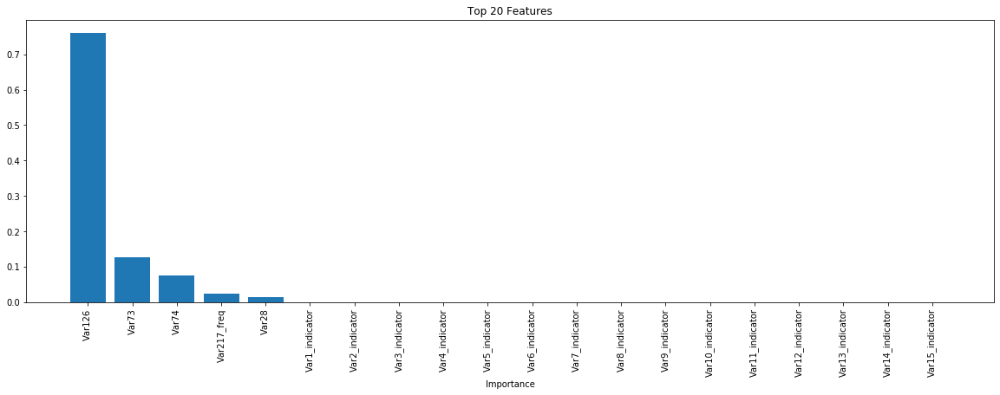

In [67]:
coef = [abs(i) for i in clf.feature_importances_]
feature_imp = dict(zip(feature_names,coef))
feature_imp = {k: v for k, v in sorted(feature_imp.items(), key=lambda item: item[1], reverse=True)}

top_20_features = {k: feature_imp[k] for k in list(feature_imp)[:20]}

fig, ax = plt.subplots(figsize=(20,6))

people = top_20_features.keys()
y_pos = np.arange(len(people))
importance = top_20_features.values()

ax.bar(y_pos, importance,align='center')
ax.set_xticks(y_pos)
ax.set_xticklabels(people)
plt.xticks(rotation=90)
# ax.invert_yaxis()
ax.set_xlabel('Importance')
ax.set_title('Top 20 Features')

plt.show()

In [63]:
# Reference : https://scikit-learn.org/stable/auto_examples/tree/plot_unveil_tree_structure.html#sphx-glr-auto-examples-tree-plot-unveil-tree-structure-py

estimator = clf

# Using those arrays, we can parse the tree structure:

n_nodes = estimator.tree_.node_count
children_left = estimator.tree_.children_left
children_right = estimator.tree_.children_right
feature = estimator.tree_.feature
threshold = estimator.tree_.threshold


# The tree structure can be traversed to compute various properties such
# as the depth of each node and whether or not it is a leaf.
node_depth = np.zeros(shape=n_nodes, dtype=np.int64)
is_leaves = np.zeros(shape=n_nodes, dtype=bool)
stack = [(0, -1)]  # seed is the root node id and its parent depth
while len(stack) > 0:
    node_id, parent_depth = stack.pop()
    node_depth[node_id] = parent_depth + 1

    # If we have a test node
    if (children_left[node_id] != children_right[node_id]):
        stack.append((children_left[node_id], parent_depth + 1))
        stack.append((children_right[node_id], parent_depth + 1))
    else:
        is_leaves[node_id] = True

print("The binary tree structure has %s nodes and has "
      "the following tree structure:"
      % n_nodes)
for i in range(n_nodes):
    if is_leaves[i]:
        print("%snode=%s leaf node." % (node_depth[i] * "\t", i))
    else:
        print("%snode=%s test node: go to node %s if X[:, %s] <= %s else to "
              "node %s."
              % (node_depth[i] * "\t",
                 i,
                 children_left[i],
                 feature[i],
                 threshold[i],
                 children_right[i],
                 ))
print()

# First let's retrieve the decision path of each sample. The decision_path
# method allows to retrieve the node indicator functions. A non zero element of
# indicator matrix at the position (i, j) indicates that the sample i goes
# through the node j.

node_indicator = estimator.decision_path(X_tr)

# Similarly, we can also have the leaves ids reached by each sample.

leave_id = estimator.apply(X_tr)

# Now, it's possible to get the tests that were used to predict a sample or
# a group of samples. First, let's make it for the sample.

sample_id = 0
node_index = node_indicator.indices[node_indicator.indptr[sample_id]:
                                    node_indicator.indptr[sample_id + 1]]

print('Rules used to predict sample %s: ' % sample_id)
for node_id in node_index:
    if leave_id[sample_id] == node_id:
        continue

    if (X_tr.iloc[sample_id, feature[node_id]] <= threshold[node_id]):
        threshold_sign = "<="
    else:
        threshold_sign = ">"

    print("decision id node %s : (X_tr[%s, %s] (= %s) %s %s)"
          % (node_id,
             sample_id,
             feature[node_id],
             X_tr.iloc[sample_id, feature[node_id]],
             threshold_sign,
             threshold[node_id]))

# For a group of samples, we have the following common node.
sample_ids = [0, 1]
common_nodes = (node_indicator.toarray()[sample_ids].sum(axis=0) ==
                len(sample_ids))

common_node_id = np.arange(n_nodes)[common_nodes]

print("\nThe following samples %s share the node %s in the tree"
      % (sample_ids, common_node_id))
print("It is %s %% of all nodes." % (100 * len(common_node_id) / n_nodes,))

The binary tree structure has 15 nodes and has the following tree structure:
node=0 test node: go to node 1 if X[:, 286] <= -0.85520139336586 else to node 8.
	node=1 test node: go to node 2 if X[:, 286] <= -1.377995789051056 else to node 5.
		node=2 test node: go to node 3 if X[:, 267] <= 0.4117812514305115 else to node 4.
			node=3 leaf node.
			node=4 leaf node.
		node=5 test node: go to node 6 if X[:, 259] <= 0.004424999933689833 else to node 7.
			node=6 leaf node.
			node=7 leaf node.
	node=8 test node: go to node 9 if X[:, 286] <= 0.08582855947315693 else to node 12.
		node=9 test node: go to node 10 if X[:, 273] <= 0.689858615398407 else to node 11.
			node=10 leaf node.
			node=11 leaf node.
		node=12 test node: go to node 13 if X[:, 274] <= -0.1272636540234089 else to node 14.
			node=13 leaf node.
			node=14 leaf node.

Rules used to predict sample 0: 
decision id node 0 : (X_tr[0, 286] (= -5.804184027491731e-18) > -0.85520139336586)
decision id node 8 : (X_tr[0, 286] (= -5.8

[Text(1860.0, 1189.125, 'X[286] <= -0.855\ngini = 0.5\nsamples = 40000\nvalue = [20000.0, 20000.0]'),
 Text(930.0, 849.375, 'X[286] <= -1.378\ngini = 0.357\nsamples = 10224\nvalue = [5387.729, 1633.764]'),
 Text(465.0, 509.625, 'X[267] <= 0.412\ngini = 0.225\nsamples = 3622\nvalue = [1931.898, 285.909]'),
 Text(232.5, 169.875, 'gini = 0.134\nsamples = 2605\nvalue = [1397.118, 108.918]'),
 Text(697.5, 169.875, 'gini = 0.374\nsamples = 1017\nvalue = [534.78, 176.991]'),
 Text(1395.0, 509.625, 'X[259] <= 0.004\ngini = 0.404\nsamples = 6602\nvalue = [3455.831, 1347.856]'),
 Text(1162.5, 169.875, 'gini = 0.39\nsamples = 6441\nvalue = [3379.202, 1218.516]'),
 Text(1627.5, 169.875, 'gini = 0.467\nsamples = 161\nvalue = [76.628, 129.34]'),
 Text(2790.0, 849.375, 'X[286] <= 0.086\ngini = 0.494\nsamples = 29776\nvalue = [14612.271, 18366.236]'),
 Text(2325.0, 509.625, 'X[273] <= 0.69\ngini = 0.466\nsamples = 13759\nvalue = [6543.09, 11123.213]'),
 Text(2092.5, 169.875, 'gini = 0.435\nsamples = 9

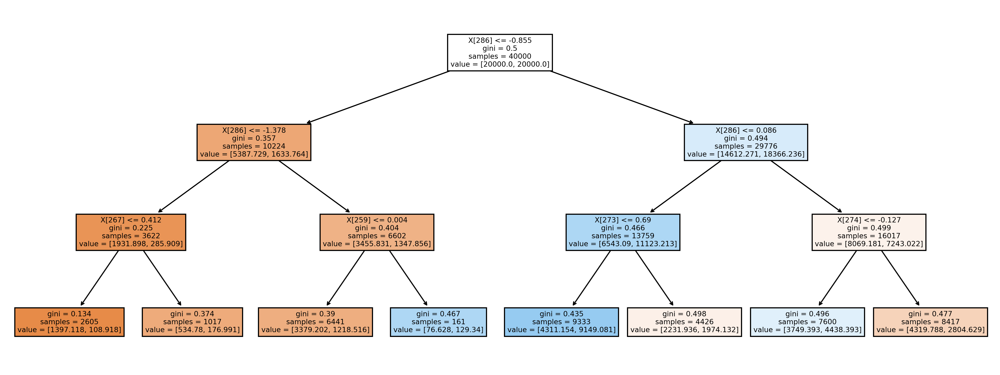

In [66]:
from sklearn.tree import plot_tree

plt.figure(figsize=(16,6),dpi=300)
plot_tree(clf, filled=True)

#### By passing multiple samples in the above function we observe the decision path lead to nodes [ 0  8  9 10] mostly.

#### Node 0 and 8 are X[286] which is Var126, it has the highest importance in the above bar chart.

#### We created a feature where if value of variable Var126 is between -0.855 and 0.08, we assigned it 1 else -1

This feature decreased the performance of XGBoost as well as logistic regression, hence we discarded it.

### KMeans

In [68]:
from sklearn.cluster import MiniBatchKMeans

In [69]:
clusters = [3,5,10,20,50,100,500,1000]

for cluster in clusters:
    kmeans = MiniBatchKMeans(n_clusters=cluster,random_state=42)
    kmeans.fit(X_tr)
    print(kmeans.score(X_tr))

-2270406.0737064895
-2059301.499594813
-1707415.8726713492
-1475093.3553115802
-1187573.9328691834
-919260.7249235121


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1676: RuntimeWarning:

init_size=300 should be larger than k=500. Setting it to 3*k

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1676: RuntimeWarning:

init_size=300 should be larger than k=500. Setting it to 3*k

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1676: RuntimeWarning:

init_size=300 should be larger than k=500. Setting it to 3*k



-790687.2044886686


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1676: RuntimeWarning:

init_size=300 should be larger than k=1000. Setting it to 3*k

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1676: RuntimeWarning:

init_size=300 should be larger than k=1000. Setting it to 3*k

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1676: RuntimeWarning:

init_size=300 should be larger than k=1000. Setting it to 3*k



-658149.8000333837


#### KMeans cluster feature importance was zero with all different cluster sizes. 

<hr>

# Final Scores on all three tasks with similar approach

## Churn

On Train Data :
              precision    recall  f1-score   support

          -1       0.97      0.71      0.82     37128
           1       0.16      0.72      0.26      2872

    accuracy                           0.71     40000
   macro avg       0.56      0.71      0.54     40000
weighted avg       0.91      0.71      0.78     40000

[[26225 10903]
 [  809  2063]]
0.794856808697338
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.96      0.70      0.81      9200
           1       0.15      0.62      0.25       800

    accuracy                           0.70     10000
   macro avg       0.56      0.66      0.53     10000
weighted avg       0.89      0.70      0.77     10000

[[6475 2725]
 [ 301  499]]
0.7262550951086958


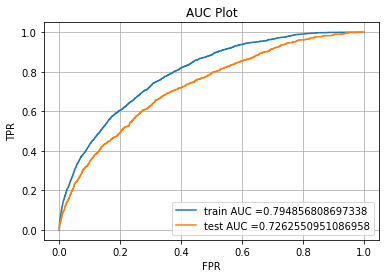

In [80]:
clf = XGBClassifier(tree_method='hist',n_estimators=200, max_depth=4, learning_rate=0.03,scale_pos_weight=12.6)
clf.fit(X_tr, y_train)

print('On Train Data :')
print(classification_report(y_train, clf.predict(X_tr)))
print(confusion_matrix(y_train, clf.predict(X_tr)))
print(roc_auc_score(y_train, clf.predict_proba(X_tr)[:,1]))
print('-'*50)


print('On Test Data :')
print(classification_report(y_test, clf.predict(X_te)))
print(confusion_matrix(y_test, clf.predict(X_te)))
print(roc_auc_score(y_test, clf.predict_proba(X_te)[:,1]))

aucPlotter(clf, X_tr, y_train, X_te, y_test)

## Appetency

On Train Data :
              precision    recall  f1-score   support

          -1       0.99      0.97      0.98     39288
           1       0.21      0.42      0.28       712

    accuracy                           0.96     40000
   macro avg       0.60      0.69      0.63     40000
weighted avg       0.98      0.96      0.97     40000

[[38157  1131]
 [  415   297]]
0.9229782759524024
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.99      0.97      0.98      9822
           1       0.15      0.30      0.20       178

    accuracy                           0.96     10000
   macro avg       0.57      0.64      0.59     10000
weighted avg       0.97      0.96      0.96     10000

[[9521  301]
 [ 124   54]]
0.8482820039397913


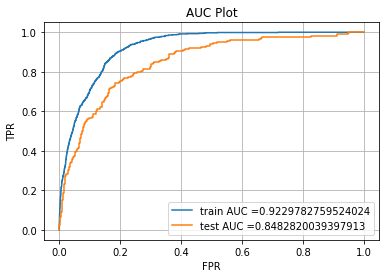

In [89]:
clf = XGBClassifier(tree_method='hist',n_estimators=200, max_depth=4, learning_rate=0.03,scale_pos_weight=12.6)
clf.fit(X_tr, y_train)

print('On Train Data :')
print(classification_report(y_train, clf.predict(X_tr)))
print(confusion_matrix(y_train, clf.predict(X_tr)))
print(roc_auc_score(y_train, clf.predict_proba(X_tr)[:,1]))
print('-'*50)


print('On Test Data :')
print(classification_report(y_test, clf.predict(X_te)))
print(confusion_matrix(y_test, clf.predict(X_te)))
print(roc_auc_score(y_test, clf.predict_proba(X_te)[:,1]))

aucPlotter(clf, X_tr, y_train, X_te, y_test)

## Upselling

On Train Data :
              precision    recall  f1-score   support

          -1       0.98      0.81      0.89     37054
           1       0.25      0.79      0.38      2946

    accuracy                           0.81     40000
   macro avg       0.61      0.80      0.63     40000
weighted avg       0.93      0.81      0.85     40000

[[29950  7104]
 [  622  2324]]
0.9009013871646785
--------------------------------------------------
On Test Data :
              precision    recall  f1-score   support

          -1       0.97      0.79      0.87      9264
           1       0.21      0.68      0.32       736

    accuracy                           0.78     10000
   macro avg       0.59      0.74      0.59     10000
weighted avg       0.91      0.78      0.83     10000

[[7318 1946]
 [ 233  503]]
0.8495972752168282


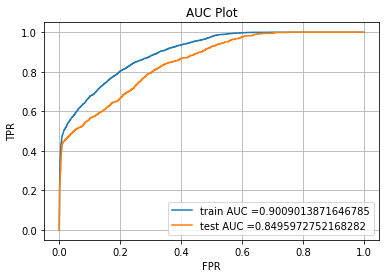

In [98]:
clf = XGBClassifier(tree_method='hist',n_estimators=200, max_depth=4, learning_rate=0.03,scale_pos_weight=12.6)
clf.fit(X_tr, y_train)

print('On Train Data :')
print(classification_report(y_train, clf.predict(X_tr)))
print(confusion_matrix(y_train, clf.predict(X_tr)))
print(roc_auc_score(y_train, clf.predict_proba(X_tr)[:,1]))
print('-'*50)


print('On Test Data :')
print(classification_report(y_test, clf.predict(X_te)))
print(confusion_matrix(y_test, clf.predict(X_te)))
print(roc_auc_score(y_test, clf.predict_proba(X_te)[:,1]))

aucPlotter(clf, X_tr, y_train, X_te, y_test)

<hr>

<table>
    <tr>
        <th>Task</th>
        <th>Winner's Score</th>
        <th>Our Score</th>
    </tr>
    <tr>
        <td>Churn</td>
        <td>0.76</td>
        <td>0.73</td>
    </tr>
    <tr>
        <td>Appetency</td>
        <td>0.87</td>
        <td>0.85</td>
    </tr>
    <tr>
        <td>Upselling</td>
        <td>0.91</td>
        <td>0.85</td>
    </tr>
    <tr>
        <th>Average</th>
        <th>0.8448</th>
        <th>0.8080</th>
    </tr>
</table>

<hr>

#### Next we will dump these models into pickle files along with scaler object, to create a pipeline and make predictions on a website.

<center>-- End -- </center>